In [1]:
import matplotlib as mpl
import eulerian_function as ef
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy
import matplotlib.ticker as ticker
import numpy as np
from matplotlib.patches import Patch
from mpl_toolkits.axes_grid1.inset_locator import InsetPosition, inset_axes
import xarray as xr
# %matplotlib widget
mpl.rcParams['figure.dpi'] = 400

In [2]:
tpoints = ef.tpoints
regions = ef.regions
tpoints_true = ef.true_tpoints(tpoints)
regions_true = ef.true_regions(regions)

## Initialisation for bar plots

In [3]:
#Args
background='no'
cyclone='min'
remove='False'#['CRCM6-GEM5-UAA-SN']
figure='False'

In [4]:
def mae_barplot(region, save='True', background=background, cyclone=cyclone, remove=remove, figure=figure):

    models, _, ds_err, _, _, _ = ef.pre_process(background, cyclone, region, remove, figure)
    models.remove('ERA5')
    
    if type(region) == list:
        for key, value in regions.items():
            if value == region:
                add = background+'-background_'+cyclone+'-cyclone_'+key
    else:
        add = background+'-background_'+cyclone+'-cyclone_'+region+'-region'

    models_sorted = sorted(models, key=lambda x: ef.model_resolution[x][1])
    bar_width = 1.0
    offset = {'psl': 0.02, 'huss': 0.0075}
    name_to_display = {'psl': ef.name_parp, 'huss': ef.name_parq}
    unit = {'psl': 'hPa', 'huss': '$g.kg^{-1}$'}

    for variable in ef.variables:

        fig_name = ef.path_out+'bar_plot_mae_'+variable+'_'+add+'.png'

        fig, ax = plt.subplots()

        total_mae   = ds_err[variable].sel(parameters='total_mae')
        linear_mae  = ds_err[variable].sel(parameters='linear_mae')

        for imod, mod in enumerate(models_sorted):
            plt.bar(imod - bar_width / 6, total_mae.sel(models=mod), bar_width / 3, label=name_to_display[variable]['total_mae'] if imod == 0 else "", color='green', edgecolor='black', linewidth=0.5)
            plt.bar(imod + bar_width / 6, linear_mae.sel(models=mod), bar_width / 3, label=name_to_display[variable]['linear_mae'] if imod == 0 else "", color='orange', edgecolor='black', linewidth=0.5)
            resolution = ef.model_resolution[mod][1]
            plt.text(imod, max(total_mae.sel(models=mod), linear_mae.sel(models=mod)) + offset[variable], f'{resolution:.2f}', ha='center', va='bottom', fontsize=4)

        plt.ylabel(name_to_display[variable]['total_mae']+' ('+unit[variable]+')')
        plt.xticks(np.arange(len(models_sorted)), models_sorted, rotation=90, fontsize=6)
        plt.xlim(-bar_width / 2 - 0.5, len(models_sorted) - 1 + bar_width / 2 + 0.5)
        plt.legend(fontsize=6)
        plt.tight_layout()

        if save != 'False': plt.savefig(fig_name, bbox_inches='tight', dpi=300)

In [5]:
def aae_barplot(region, save='True', background=background, cyclone=cyclone, remove=remove, figure=figure):

    models, _, ds_err, _, _, _ = ef.pre_process(background, cyclone, region, remove, figure)
    models.remove('ERA5')
    
    if type(region) == list:
        for key, value in regions.items():
            if value == region:
                add = background+'-background_'+cyclone+'-cyclone_'+key
    else:
        add = background+'-background_'+cyclone+'-cyclone_'+region+'-region'

    # models_sorted = sorted(models, key=lambda x: ef.model_resolution[x][1])
    bar_width = 0.75
    offset = {'psl': 0.1, 'huss': 0.025}
    name_to_display = {'psl': ef.name_parp, 'huss': ef.name_parq}
    unit = {'psl': 'hPa', 'huss': '$g.kg^{-1}$'}

    for variable in ef.variables:

        fig_name = ef.path_out+'bar_plot_aae_'+variable+'_'+add+'.png'

        fig, ax = plt.subplots()

        min_mae   = ds_err[variable].sel(parameters='min_mae')
        slope_mae = ds_err[variable].sel(parameters='slope_mae')
        asymm_mae = ds_err[variable].sel(parameters='asymm_mae')

        for imod, mod in enumerate(models):
            plt.bar(imod, min_mae.sel(models=mod), bar_width, label=name_to_display[variable]['min_mae'] if imod == 0 else "", color='gray', edgecolor='black', linewidth=0.5)
            plt.bar(imod, slope_mae.sel(models=mod), bar_width, bottom=min_mae.sel(models=mod), label=name_to_display[variable]['slope_mae'] if imod == 0 else "", color='orange', edgecolor='black', linewidth=0.5)
            plt.bar(imod, asymm_mae.sel(models=mod), bar_width, bottom=min_mae.sel(models=mod) + slope_mae.sel(models=mod), label=name_to_display[variable]['asymm_mae'] if imod == 0 else "", color='blue', edgecolor='black', linewidth=0.5)
            resolution = ef.model_resolution[mod][1]
            plt.text(imod, min_mae.sel(models=mod) + slope_mae.sel(models=mod) + asymm_mae.sel(models=mod) + offset[variable], f'{resolution:.2f}', ha='center', va='bottom', fontsize=4)

        plt.ylabel(name_to_display[variable]['total_aae']+' ('+unit[variable]+')')
        plt.xticks(np.arange(len(models)), models, rotation=90, fontsize=6)
        plt.xlim(-bar_width / 2 - 0.5, len(models) - 1 + bar_width / 2 + 0.5)
        plt.legend(fontsize=6)
        plt.tight_layout()

        if save != 'False': plt.savefig(fig_name, bbox_inches='tight', dpi=300)

In [6]:
def aae_barplot_ranking(region, plim, qlim, save='True', background=background, cyclone=cyclone, remove=remove, figure=figure):

    #Figure 6 comes from this
    
    _, _, ds_err, _, _, _ = ef.pre_process(background, cyclone, region, remove, figure)

    ds_err = xr.concat([ds_err, 
                        ds_err.sel(models=[m for m in ds_err.models.values if m not in ['CRCM6-GEM5-UAA-SN', 'CRCM6-GEM5-UAA']]).mean(dim="models").assign_coords(models=["ENSEMBLE-MEAN"])], dim="models")

    if type(region) == list:
        for key, value in regions.items():
            if value == region:
                add = background+'-background_'+cyclone+'-cyclone_'+key
    else:
        add = background+'-background_'+cyclone+'-cyclone_'+region+'-region'

    # models_sorted = sorted(models, key=lambda x: ef.model_resolution[x][1])
    bar_width = 0.75
    locator = {'psl': [5, 2.5], 'huss': [1, 0.5]}
    name_to_display = {'psl': ef.name_parp, 'huss': ef.name_parq}
    unit = {'psl': 'hPa', 'huss': r'g.kg$^{-1}$'}
    lim = {'psl': plim, 'huss': qlim}

    for variable in ef.variables:

        fig_name = ef.path_out+'bar_plot_ranking_aae_'+variable+'_'+add+'.png'

        fig, ax = plt.subplots()

        min_mae   = ds_err[variable].sel(parameters='min_mae')
        slope_mae = ds_err[variable].sel(parameters='slope_mae')
        asymm_mae = ds_err[variable].sel(parameters='asymm_mae')

        sorted_ds_err = ds_err[variable].sel(parameters='total_aae').sortby(ds_err[variable].sel(parameters='total_aae'))
   

        for imod, mod in enumerate(sorted_ds_err.models):
            plt.bar(imod, min_mae.sel(models=mod), bar_width, label=name_to_display[variable]['min_mae'] if imod == 0 else "", color='gray', edgecolor='black', linewidth=0.5)
            plt.bar(imod, slope_mae.sel(models=mod), bar_width, bottom=min_mae.sel(models=mod), label=name_to_display[variable]['slope_mae'] if imod == 0 else "", color='orange', edgecolor='black', linewidth=0.5)
            plt.bar(imod, asymm_mae.sel(models=mod), bar_width, bottom=min_mae.sel(models=mod) + slope_mae.sel(models=mod), label=name_to_display[variable]['asymm_mae'] if imod == 0 else "", color='blue', edgecolor='black', linewidth=0.5)
            # resolution = ef.model_resolution[mod][1]
            # plt.text(imod, min_mae.sel(models=mod) + slope_mae.sel(models=mod) + asymm_mae.sel(models=mod) + offset[variable], f'{resolution:.2f}', ha='center', va='bottom', fontsize=4)

        if region == regions['gulf_mexico'] and variable == 'huss':
            ax.yaxis.set_major_locator(ticker.MultipleLocator(2))
            ax.yaxis.set_minor_locator(ticker.MultipleLocator(0.5))	
        else:
            ax.yaxis.set_major_locator(ticker.MultipleLocator(locator[variable][0]))
            ax.yaxis.set_minor_locator(ticker.MultipleLocator(locator[variable][1]))
        # ax.minorticks_on()
        ax.tick_params(which='major', length=8, width=1.5, colors='black', axis='y')
        ax.tick_params(which='minor', length=4, width=1, colors='black', axis='y')
        ax.tick_params(which='major', length=5, width=1, colors='black', axis='x')
        ax.tick_params(axis='x', which='major', labelrotation=90, labelsize=10, direction='out')
        ax.tick_params(axis='x', which='minor', bottom=False, top=False)
        ax.tick_params(axis='y', which='both', right=False, direction='inout', labelsize=14)
        ax.set_ylabel(f"{name_to_display[variable]['total_aae']} ({unit[variable]})", fontsize=17)
        ax.set_xticks(np.arange(len(sorted_ds_err.models.values)))
        # ax.set_xticklabels(sorted_ds_err.models.values)

        xticks = []
        for mod in sorted_ds_err.models.values:
            if mod == "ENSEMBLE-MEAN":
                color = 'black'
                size = 9
                weight = 'bold'
            elif mod in ['CRCM6-GEM5-UBD', 'EC-Earth3-Veg']:
                color = '#56B4E9'
                size = 10
                weight = 'normal'
            elif mod in ['CRCM6-GEM5-UBE', 'MPI-ESM1-2-HR']:
                color = '#009E73'
                size = 10
                weight = 'normal'
            elif mod in ['CRCM6-GEM5-UBF', 'MIROC6']:
                color = '#CC79A7'
                size = 10
                weight = 'normal'
            else:
                color = 'black'
                size = 10
                weight = 'normal'
            xticks.append((mod, color, size, weight))

        # Applique les étiquettes (texte brut)
        ax.set_xticklabels([t[0] for t in xticks])

        # Applique les styles individuels à chaque étiquette
        for label, (_, color, size, weight) in zip(ax.get_xticklabels(), xticks):
            label.set_color(color)
            label.set_fontsize(size)
            label.set_fontweight(weight)

        ax.set_xlim(-bar_width / 2 - 0.5, len(sorted_ds_err.models.values) - 1 + bar_width / 2 + 0.5)
        ax.set_ylim(0, lim[variable])
        ax.legend(fontsize=10,ncol=3)
        # ax.set_axisbelow(True)
        # ax.grid(True, which='major', axis='y', linestyle='-', linewidth=0.3, c='black')
        # ax.grid(True, which='minor', axis='y', linestyle='--', linewidth=0.2)
        plt.tight_layout()

        if save != 'False': plt.savefig(fig_name, bbox_inches='tight', dpi=300)

In [7]:
def aae_barplot_large(region, save='True', background=background, cyclone=cyclone, remove=remove, figure=figure):

    models, _, ds_err, _, _, _ = ef.pre_process(background, cyclone, region, remove, figure)
    models.remove('ERA5')
    
    if type(region) == list:
        for key, value in regions.items():
            if value == region:
                add = background+'-background_'+cyclone+'-cyclone_'+key
    else:
        add = background+'-background_'+cyclone+'-cyclone_'+region+'-region'

    # models_sorted = sorted(models, key=lambda x: ef.model_resolution[x][1])
    bar_width = 0.2
    locator = {'psl': [5, 1], 'huss': [0.5, 0.1]}
    lim = {'psl': 15, 'huss': 3}
    name_to_display = {'psl': ef.name_parp, 'huss': ef.name_parq}
    unit = {'psl': 'hPa', 'huss': '$g.kg^{-1}$'}

    for variable in ef.variables:

        fig_name = ef.path_out+'bar_plot_aae_'+variable+'_'+add+'.png'

        fig, ax = plt.subplots()

        min_mae   = ds_err[variable].sel(parameters='min_mae')
        slope_mae = ds_err[variable].sel(parameters='slope_mae')
        asymm_mae = ds_err[variable].sel(parameters='asymm_mae')
        total_aae = ds_err[variable].sel(parameters='total_aae')

        for imod, mod in enumerate(models):
            
            plt.bar(imod - bar_width - bar_width / 2, total_aae.sel(models=mod), bar_width, label=name_to_display[variable]['total_aae'] if imod == 0 else "", color='green', edgecolor='black', linewidth=0.5, zorder=3)            
            plt.bar(imod - bar_width / 2, min_mae.sel(models=mod),   bar_width, label=name_to_display[variable]['min_mae']   if imod == 0 else "", color='gray', edgecolor='black', linewidth=0.5, zorder=1)
            plt.bar(imod + bar_width / 2, slope_mae.sel(models=mod), bar_width, label=name_to_display[variable]['slope_mae'] if imod == 0 else "", color='orange', edgecolor='black', linewidth=0.5, zorder=2)
            plt.bar(imod + bar_width + bar_width / 2, asymm_mae.sel(models=mod), bar_width, label=name_to_display[variable]['asymm_mae'] if imod == 0 else "", color='blue', edgecolor='black', linewidth=0.5, zorder=4)

            # plt.bar(imod + bar_width + bar_width/2, min_mae.sel(models=mod),   bar_width / 4, color='white', edgecolor='black', linewidth=0.5)
            # plt.bar(imod + bar_width + bar_width/2, slope_mae.sel(models=mod), bar_width / 4, bottom=min_mae.sel(models=mod), color='white', edgecolor='black', linewidth=0.5)
            # plt.bar(imod + bar_width + bar_width/2, asymm_mae.sel(models=mod), bar_width / 4, bottom=min_mae.sel(models=mod) + slope_mae.sel(models=mod), label=name_to_display[variable]['total_aae'] if imod == 0 else "", color='white', edgecolor='black', linewidth=0.5)

            # resolution = ef.model_resolution[mod][1]
            # plt.text(imod, min_mae.sel(models=mod) + slope_mae.sel(models=mod) + asymm_mae.sel(models=mod) + offset[variable], f'{resolution:.2f}', ha='center', va='bottom', fontsize=4)

        ax.yaxis.set_major_locator(ticker.MultipleLocator(locator[variable][0]))
        ax.yaxis.set_minor_locator(ticker.MultipleLocator(locator[variable][1]))
        ax.minorticks_on()
        ax.tick_params(which='major', colors='black')
        ax.tick_params(which='minor', colors='gray')
        ax.tick_params(axis='x', which='major', labelrotation=90, labelsize=6, direction='out')
        ax.tick_params(axis='x', which='minor', bottom=False, top=False)
        ax.tick_params(axis='y', which='both', right=True, direction='inout')
        ax.set_ylabel(f"{name_to_display[variable]['total_aae']} ({unit[variable]})")
        ax.set_xticks(np.arange(len(models)))
        ax.set_xticklabels(models)
        ax.set_xlim(-bar_width / 2 - 1, len(models) - 1 + bar_width / 2 + 1)
        ax.set_ylim(0, lim[variable])
        ax.legend(fontsize=6)
        ax.grid(True, which='major', axis='y', linestyle='-', linewidth=0.15, c='black')
        ax.grid(True, which='minor', axis='y', linestyle='--', linewidth=0.1)
        plt.tight_layout()
        
        if save != 'False': plt.savefig(fig_name, bbox_inches='tight', dpi=300)

In [8]:
def summary_aae_barplot(region, save='True', background=background, cyclone=cyclone, remove=remove, figure=figure):

    models, _, ds_err, _, _, _ = ef.pre_process(background, cyclone, region, remove, figure)
    models.remove('ERA5')
    models_sorted = sorted(models, key=lambda x: ef.model_resolution[x][1])

    bar_width = 0.4
    name_to_display = {'psl': ef.name_parp, 'huss': ef.name_parq}
    unit = {'psl': 'hPa', 'huss': '$g.kg^{-1}$'}
    letter = {'psl': 'p', 'huss': 'q'}
    xticks_var = {'psl': -bar_width/2, 'huss': bar_width/2}
    color = {
    'psl': {'min_mae': 'gray', 'slope_mae': 'orange', 'asymm_mae': 'blue'},
    'huss': {'min_mae': '#2d2d2d', 'slope_mae': '#b36b00', 'asymm_mae': '#00006b'}
}

    fig, ax = plt.subplots(figsize=(10, 5))
    ax2 = ax.twinx()
    current_ax = {'psl': ax, 'huss': ax2}

    for variable in ef.variables:
        
        min_mae   = ds_err[variable].sel(parameters='min_mae')
        slope_mae = ds_err[variable].sel(parameters='slope_mae')
        asymm_mae = ds_err[variable].sel(parameters='asymm_mae')

        for imod, mod in enumerate(models_sorted):
                    
            current_ax[variable].bar(imod + xticks_var[variable], min_mae.sel(models=mod),   bar_width, label=name_to_display[variable]['min_mae'] if imod == 0 else "", color=color[variable]['min_mae'], edgecolor='black', linewidth=0.5)
            current_ax[variable].bar(imod + xticks_var[variable], slope_mae.sel(models=mod), bar_width, bottom=min_mae.sel(models=mod), label=name_to_display[variable]['slope_mae'] if imod == 0 else "", color=color[variable]['slope_mae'], edgecolor='black', linewidth=0.5)
            current_ax[variable].bar(imod + xticks_var[variable], asymm_mae.sel(models=mod), bar_width, bottom=min_mae.sel(models=mod) + slope_mae.sel(models=mod), label=name_to_display[variable]['asymm_mae'] if imod == 0 else "", color=color[variable]['asymm_mae'], edgecolor='black', linewidth=0.5)


    ax.axhline(0, color='black', linewidth=0.8, alpha=1, zorder=0)
    ax.set_ylabel(name_to_display['psl']['total_aae']+' ('+unit['psl']+')')
    ax.set_xticks(np.arange(len(models_sorted)))
    ax.set_xticklabels(models_sorted, rotation=90, fontsize=8)
    ax.set_xlim(-bar_width / 2 - 0.5, (len(models_sorted) - 1) + bar_width / 2 + 0.5)
    ax.legend(fontsize=6, loc='upper left')

    ax2.set_ylabel(name_to_display['huss']['total_aae']+' ('+unit['huss']+')')
    ax2.legend(fontsize=6, loc='upper right')

    plt.tight_layout()

In [9]:
def grp_res_aae_barplot(region, save='True', background=background, cyclone=cyclone, remove=remove, figure=figure):

    _, _, ds_err, _, _, _ = ef.pre_process(background, cyclone, region, remove, figure)

    bar_width = 0.4
    name_to_display = {'psl': ef.name_parp, 'huss': ef.name_parq}
    unit = {'psl': 'hPa', 'huss': '$g.kg^{-1}$'}
    letter = {'psl': 'p', 'huss': 'q'}
    xticks_var = {'psl': -bar_width/2, 'huss': bar_width/2}
    color = {
        'psl': {'min_mae': 'gray', 'slope_mae': 'orange', 'asymm_mae': 'blue'},
        'huss': {'min_mae': '#2d2d2d', 'slope_mae': '#b36b00', 'asymm_mae': '#00006b'}
    }

    fig, ax = plt.subplots(figsize=(5, 5))
    ax2 = ax.twinx()
    current_ax = {'psl': ax, 'huss': ax2}

    for variable in ef.variables:
        for igrp, grp in enumerate(ef.grp_mod_res.keys()):

            valid_models = [model for model in ef.grp_mod_res[grp] if model in ds_err[variable].models and model not in ['CRCM6-GEM5-UAA-SN', 'CRCM6-GEM5-UAA']]

            min_mae   = ds_err[variable].sel(parameters='min_mae',   models=valid_models).median()
            slope_mae = ds_err[variable].sel(parameters='slope_mae', models=valid_models).median()
            asymm_mae = ds_err[variable].sel(parameters='asymm_mae', models=valid_models).median()
        
            current_ax[variable].bar(igrp + xticks_var[variable], min_mae,   bar_width, label=name_to_display[variable]['min_mae'] if igrp == 0 else "", color=color[variable]['min_mae'], edgecolor='black', linewidth=0.5)
            current_ax[variable].bar(igrp + xticks_var[variable], slope_mae, bar_width, bottom=min_mae, label=name_to_display[variable]['slope_mae'] if igrp == 0 else "", color=color[variable]['slope_mae'], edgecolor='black', linewidth=0.5)
            current_ax[variable].bar(igrp + xticks_var[variable], asymm_mae, bar_width, bottom=min_mae + slope_mae, label=name_to_display[variable]['asymm_mae'] if igrp == 0 else "", color=color[variable]['asymm_mae'], edgecolor='black', linewidth=0.5)

    ax.axhline(0, color='black', linewidth=0.8, alpha=1, zorder=0)

    ax.set_ylabel(name_to_display['psl']['total_aae']+' ('+unit['psl']+')')
    ax.set_xticks([0, 1, 2, 3])
    ax.set_xticklabels(['RCM', 'High\nResolution', 'Medium\nResolution', 'Low\nResolution'], fontsize=8)
    ax.set_xlim(-bar_width / 2 - 0.5, (len([0, 1, 2, 3]) - 1) + bar_width / 2 + 0.5)
    ax.legend(fontsize=6, loc='upper left')

    ax2.set_ylabel(name_to_display['huss']['total_aae']+' ('+unit['huss']+')')
    ax2.legend(fontsize=6, loc='upper left', bbox_to_anchor=(0.18, 1))

    plt.tight_layout()

In [10]:
def grp_res_aae_boxplot(region, save='True', background=background, cyclone=cyclone, remove=remove, figure=figure):

    _, _, ds_err, _, _, _ = ef.pre_process(background, cyclone, region, remove, figure)

    name_to_display = {'psl': ef.name_parp, 'huss': ef.name_parq}
    unit = {'psl': 'hPa', 'huss': '$g.kg^{-1}$'}
    color = {'min_mae': 'gray', 'slope_mae': 'orange', 'asymm_mae': 'blue', 'total_aae': 'green'}

    name_to_display = {'psl': ef.name_parp, 'huss': ef.name_parq}
    unit = {'psl': 'hPa', 'huss': '$g.kg^{-1}$'}
    width = 0.12

    for variable in ef.variables:

        fig, ax = plt.subplots()

        for igrp, grp in enumerate(ef.grp_mod_res.keys()):

            valid_models = [model for model in ef.grp_mod_res[grp] if model in ds_err[variable].models and model not in ['CRCM6-GEM5-UAA-SN', 'CRCM6-GEM5-UAA']]

            min_mae = ds_err[variable].sel(parameters='min_mae', models=valid_models)
            slope_mae = ds_err[variable].sel(parameters='slope_mae', models=valid_models)
            asymm_mae = ds_err[variable].sel(parameters='asymm_mae', models=valid_models)
            total_aae = ds_err[variable].sel(parameters='total_aae', models=valid_models)

            ax.boxplot(min_mae,   positions=[igrp + 1 - width - width/2], widths=width, patch_artist=True, 
                       boxprops=dict(facecolor=color['min_mae'], color='black', linewidth=0.5), 
                       medianprops=dict(color='black', linewidth=0.5), whiskerprops=dict(linewidth=0.5), 
                       capprops=dict(linewidth=0.5), flierprops=dict(marker='x', markersize=3, linestyle='none', markeredgecolor='black'))
            ax.boxplot(slope_mae, positions=[igrp + 1 - width + width/2], widths=width, patch_artist=True, 
                       boxprops=dict(facecolor=color['slope_mae'], color='black', linewidth=0.5), 
                       medianprops=dict(color='black', linewidth=0.5), whiskerprops=dict(linewidth=0.5), 
                       capprops=dict(linewidth=0.5), flierprops=dict(marker='x', markersize=3, linestyle='none', markeredgecolor='black'))
            ax.boxplot(asymm_mae, positions=[igrp + 1 + width - width/2], widths=width, patch_artist=True, 
                       boxprops=dict(facecolor=color['asymm_mae'], color='black', linewidth=0.5), 
                       medianprops=dict(color='black', linewidth=0.5), whiskerprops=dict(linewidth=0.5), 
                       capprops=dict(linewidth=0.5), flierprops=dict(marker='x', markersize=3, linestyle='none', markeredgecolor='black'))
            ax.boxplot(total_aae, positions=[igrp + 1 + width + width/2], widths=width, patch_artist=True, 
                       boxprops=dict(facecolor=color['total_aae'], color='black', linewidth=0.5), 
                       medianprops=dict(color='black', linewidth=0.5), whiskerprops=dict(linewidth=0.5), 
                       capprops=dict(linewidth=0.5), flierprops=dict(marker='x', markersize=3, linestyle='none', markeredgecolor='black'))

        handles = [
            Patch(facecolor=color['min_mae'],   edgecolor='black', lw=0.5, label=name_to_display[variable]['min_mae']),
            Patch(facecolor=color['slope_mae'], edgecolor='black', lw=0.5, label=name_to_display[variable]['slope_mae']),
            Patch(facecolor=color['asymm_mae'], edgecolor='black', lw=0.5, label=name_to_display[variable]['asymm_mae']),
            Patch(facecolor=color['total_aae'], edgecolor='black', lw=0.5, label=name_to_display[variable]['total_aae'])
        ]
        
        plt.ylabel(name_to_display[variable]['total_aae']+' ('+unit[variable]+')')
        plt.xticks([1, 2, 3, 4], ['RCM', 'High\nResolution', 'Medium\nResolution', 'Low\nResolution'], fontsize=8)
        plt.ylim(0, None)
        plt.legend(handles=handles, fontsize=6, loc='upper left')
        plt.tight_layout()

In [11]:
def bias_barplot(region, plim, qlim, save='True', background=background, cyclone=cyclone, remove=remove, figure=figure):

    models, ds_bias, _, _, _, _ = ef.pre_process(background, cyclone, region, remove, figure)
    models.remove('ERA5')

    if type(region) == list:
        for key, value in regions.items():
            if value == region:
                add = background+'-background_'+cyclone+'-cyclone_'+key
    else:
        add = background+'-background_'+cyclone+'-cyclone_'+region+'-region'

    # models_sorted = sorted(models, key=lambda x: ef.model_resolution[x][1])
    bar_width = 0.75
    offset = {'psl': 0.1, 'huss': 0.025}
    name_to_display = {'psl': ef.name_parp, 'huss': ef.name_parq}
    unit = {'psl': 'hPa', 'huss': '$g.kg^{-1}$'}
    letter = {'psl': 'p', 'huss': 'q'}

    for variable in ef.variables:

        fig_name = ef.path_out+'bar_plot_bias_'+variable+'_'+add+'.png'

        if variable == 'psl':
            lim = plim
        else:
            lim = qlim


        fig, ax = plt.subplots()

        # min_mae   = ds_bias[variable].sel(parameters='min')
        slope_mae = ds_bias[variable].sel(parameters='slope')*36
        asymm_mae = ds_bias[variable].sel(parameters='asymm')*36

        for imod, mod in enumerate(models):

            bottom_pos = 0
            bottom_neg = 0
            
            plt.bar(imod, min_mae.sel(models=mod), bar_width, label=name_to_display[variable]['min_bias'] if imod == 0 else "", color='gray', edgecolor='black', linewidth=0.5)
            
            if min_mae.sel(models=mod) > 0:
                bottom_pos += min_mae.sel(models=mod).values
            else:
                bottom_neg += min_mae.sel(models=mod).values

            if slope_mae.sel(models=mod) > 0:
                plt.bar(imod, slope_mae.sel(models=mod), bar_width, bottom=bottom_pos, label=name_to_display[variable]['slope_bias'] if imod == 0 else "", color='orange', edgecolor='black', linewidth=0.5)
                bottom_pos += slope_mae.sel(models=mod).values
            else:
                plt.bar(imod, slope_mae.sel(models=mod), bar_width, bottom=bottom_neg, label=name_to_display[variable]['slope_bias'] if imod == 0 else "", color='orange', edgecolor='black', linewidth=0.5)
                bottom_neg += slope_mae.sel(models=mod).values

            if asymm_mae.sel(models=mod) > 0:
                plt.bar(imod, asymm_mae.sel(models=mod), bar_width, bottom=bottom_pos, label=name_to_display[variable]['asymm_bias'] if imod == 0 else "", color='blue', edgecolor='black', linewidth=0.5)
                bottom_pos += asymm_mae.sel(models=mod).values
            else:
                plt.bar(imod, asymm_mae.sel(models=mod), bar_width, bottom=bottom_neg, label=name_to_display[variable]['asymm_bias'] if imod == 0 else "", color='blue', edgecolor='black', linewidth=0.5)
                bottom_neg += asymm_mae.sel(models=mod).values

        ax.axhline(0, color='black', linewidth=0.8, alpha=1, zorder=0)
        plt.ylim(-lim,lim)
        plt.ylabel('${'+letter[variable]+'}_{bias}$ ('+unit[variable]+')')
        plt.xticks(np.arange(len(models)), models, rotation=90, fontsize=6)
        plt.xlim(-bar_width / 2 - 0.5, len(models) - 1 + bar_width / 2 + 0.5)
        plt.legend(fontsize=6, loc='upper left')
        plt.tight_layout()

        if save != 'False': plt.savefig(fig_name, bbox_inches='tight', dpi=300)

In [12]:
def bias_barplot_large(region, plim, qlim, save='True', background=background, cyclone=cyclone, remove=remove, figure=figure):

    #Old Figures for bias barplot in region
    
    models, ds_bias, _, ds_era, _, _ = ef.pre_process(background, cyclone, region, remove, figure)
    models.remove('ERA5')

    if isinstance(region, list):
        for key, value in regions.items():
            if value == region:
                add = background+'-background_'+cyclone+'-cyclone_'+key
    else:
        add = background+'-background_'+cyclone+'-cyclone_'+region+'-region'

    bar_width = 0.22
    locator = {'psl': [5, 1], 'huss': [0.5, 0.1]}
    name_to_display = {'psl': ef.name_parp, 'huss': ef.name_parq}
    name_to_display_bold = {'psl': ef.name_parp_bold, 'huss': ef.name_parq_bold}
    unit = {'psl': 'hPa', 'huss': r'g.kg$^{-1}$'}
    letter = {'psl': 'p', 'huss': 'q'}

    fig_name = ef.path_out+'bar_plot_bias_'+add+'.png'
    fig, axs = plt.subplots(2, 1, sharex=True, figsize=(6, 6))

    for i, variable in enumerate(ef.variables):
        ax = axs[i]

        min_mae   = ds_bias[variable].sel(parameters='min')
        slope_mae = ds_bias[variable].sel(parameters='slope')*36
        asymm_mae = ds_bias[variable].sel(parameters='asymm')*36

        min_mae_era   = ds_era[variable].sel(parameters='min')
        slope_mae_era = ds_era[variable].sel(parameters='slope')*36
        asymm_mae_era = ds_era[variable].sel(parameters='asymm')*36

        if variable == 'huss' and (max(abs(min_mae)) > 5 or max(abs(slope_mae)) > 5 or max(abs(asymm_mae)) > 5):
            locator[variable] = [2.5, 1]
        if variable == 'psl' and max(max(abs(min_mae)), max(abs(slope_mae)), max(abs(asymm_mae))) < 10 :
            locator[variable] = [2.5, 0.5]

        lim = plim if variable == 'psl' else qlim

        textstr = (
            f"ERA5 ({unit[variable]}) : "
            f"{name_to_display_bold[variable]['min']} = {np.round(min_mae_era.mean().values, 2)}; "
            f"{name_to_display_bold[variable]['slope']} = {np.round(slope_mae_era.mean().values, 2)}; "
            f"{name_to_display_bold[variable]['asymm']} = {np.round(asymm_mae_era.mean().values, 2)}"
        )

        for imod, mod in enumerate(models):
            ax.bar(imod - bar_width, min_mae.sel(models=mod),   bar_width, label=name_to_display[variable]['min_bias'] if imod == 0 else "",   color='gray',   edgecolor='black', linewidth=0.5)
            ax.bar(imod,             slope_mae.sel(models=mod), bar_width, label=name_to_display[variable]['slope_bias'] if imod == 0 else "", color='orange', edgecolor='black', linewidth=0.5)
            ax.bar(imod + bar_width, asymm_mae.sel(models=mod), bar_width, label=name_to_display[variable]['asymm_bias'] if imod == 0 else "", color='blue',   edgecolor='black', linewidth=0.5)

        ax.axhline(0, color='black', linewidth=0.8, alpha=1, zorder=0)
        ax.yaxis.set_major_locator(ticker.MultipleLocator(locator[variable][0]))
        ax.yaxis.set_minor_locator(ticker.MultipleLocator(locator[variable][1]))
        ax.minorticks_on()
        ax.tick_params(which='major', length=6, width=1.25, colors='black', axis='y')
        ax.tick_params(which='minor', length=4, width=0.75, colors='gray', axis='y')
        ax.tick_params(which='major', length=5, width=1, colors='black', axis='x')
        ax.tick_params(axis='x', which='major', labelrotation=90, labelsize=10, direction='out')
        ax.tick_params(axis='x', which='minor', bottom=False, top=False)
        ax.tick_params(axis='y', which='both', right=False, direction='inout', labelsize=12)
        ax.set_ylim(-lim, lim)
        ax.set_ylabel(f'${{{letter[variable]}}}_{{bias}}$ ({unit[variable]})', fontsize=17)
        ax.set_xticks(np.arange(len(models)))
        ax.set_xticklabels(models)

        xticks = []
        for mod in models:
            if mod == "ENSEMBLE-MEAN":
                color = 'black'
                size = 9
                weight = 'bold'
            elif mod in ['CRCM6-GEM5-UBD', 'EC-Earth3-Veg']:
                color = '#56B4E9'
                size = 10
                weight = 'normal'
            elif mod in ['CRCM6-GEM5-UBE', 'MPI-ESM1-2-HR']:
                color = '#009E73'
                size = 10
                weight = 'normal'
            elif mod in ['CRCM6-GEM5-UBF', 'MIROC6']:
                color = '#CC79A7'
                size = 10
                weight = 'normal'
            else:
                color = 'black'
                size = 10
                weight = 'normal'
            xticks.append((mod, color, size, weight))

        # Applique les étiquettes (texte brut)
        ax.set_xticklabels([t[0] for t in xticks])

        # Applique les styles individuels à chaque étiquette
        for label, (_, color, size, weight) in zip(ax.get_xticklabels(), xticks):
            label.set_color(color)
            label.set_fontsize(size)
            label.set_fontweight(weight)


        ax.set_xlim(-bar_width - 0.5, len(models) - 1 + bar_width + 0.5)
        ax.grid(True, which='major', axis='y', linestyle='-', linewidth=0.15, c='black')
        # ax.grid(True, which='minor', axis='y', linestyle='--', linewidth=0.1)
        if region == regions['w_canada']:
            ax.text(0.01, 0.91, textstr, fontsize=9, verticalalignment='bottom', horizontalalignment='left', transform=ax.transAxes, bbox=dict(facecolor='white', alpha=0, edgecolor='none'), fontweight='bold')
        # elif region == regions['w_canada']:
        #     ax.text(0.31, 0.01, textstr, fontsize=9, verticalalignment='bottom', horizontalalignment='left', transform=ax.transAxes, bbox=dict(facecolor='white', alpha=0, edgecolor='none'), fontweight='bold')
        else:
            ax.text(0.01, 0.01, textstr, fontsize=9, verticalalignment='bottom', horizontalalignment='left', transform=ax.transAxes, bbox=dict(facecolor='white', alpha=0, edgecolor='none'), fontweight='bold')
        if region == regions['quebec'] and variable == 'huss': ax.legend(fontsize=9, loc='upper left', ncol=3)
        else: ax.legend(fontsize=9, bbox_to_anchor=(0.1, 0, 0.9, 1), ncol=3)
        plt.tight_layout(h_pad=0.5)

        if save != 'False': plt.savefig(fig_name, bbox_inches='tight', dpi=300)


In [13]:
def bias_aae_barplot_large_ranking(region, plim_bias, qlim_bias, plim_aae, qlim_aae, save='True', background=background, cyclone=cyclone, remove=remove, figure=figure):

    #Regional Figures come from this
    
    models, ds_bias, ds_err, ds_era, _, _ = ef.pre_process(background, cyclone, region, remove, figure)
    models.remove('ERA5')

    # ds_err = xr.concat([ds_err, 
    #                     ds_err.sel(models=[m for m in ds_err.models.values if m not in ['CRCM6-GEM5-UAA-SN', 'CRCM6-GEM5-UAA']]).mean(dim="models").assign_coords(models=["ENSEMBLE-MEAN"])], dim="models")

    if isinstance(region, list):
        for key, value in regions.items():
            if value == region:
                add = background+'-background_'+cyclone+'-cyclone_'+key
    else:
        add = background+'-background_'+cyclone+'-cyclone_'+region+'-region'

    bar_width_bias = 0.22
    bar_width_aae = 0.75
    locator = {'psl': {'bias': [10, 5], 'aae': [10, 5]}, 'huss': {'bias': [1, 0.5], 'aae': [1, 0.5]}}
    name_to_display = {'psl': ef.name_parp, 'huss': ef.name_parq}
    name_to_display_bold = {'psl': ef.name_parp_bold, 'huss': ef.name_parq_bold}
    unit = {'psl': 'hPa', 'huss': r'g.kg$^{-1}$'}
    letter = {'psl': 'p', 'huss': 'q'}
    lim = {'psl': {'bias': plim_bias, 'aae': plim_aae}, 'huss': {'bias': qlim_bias, 'aae': qlim_aae}}

    fig_name = ef.path_out+'bar_plot_'+add+'.png'
    fig, axs = plt.subplots(2, 2, figsize=(12, 6))
    for ax in axs[1:,0]:
        ax.sharex(axs[0,0])
    for ax in axs[1:,1]:
        ax.sharex(axs[0,1])
    for ax in axs[0, :]:
        ax.tick_params(labelbottom=False)

    for i, error in enumerate(['bias', 'aae']):

        for j, variable in enumerate(ef.variables):

            sorted_ds_err = ds_err[variable].sel(parameters='total_aae').sortby(ds_err[variable].sel(parameters='total_aae'))

            ax = axs[i][j]

            if error == 'bias':
                min_mae_bias   = ds_bias[variable].sel(parameters='min')
                slope_mae_bias = ds_bias[variable].sel(parameters='slope')*36
                asymm_mae_bias = ds_bias[variable].sel(parameters='asymm')*36

                min_mae_era_bias   = ds_era[variable].sel(parameters='min')
                slope_mae_era_bias = ds_era[variable].sel(parameters='slope')*36
                asymm_mae_era_bias = ds_era[variable].sel(parameters='asymm')*36

                textstr = (
                    f"ERA5 ({unit[variable]}) : "
                    f"{name_to_display_bold[variable]['min']} = {np.round(min_mae_era_bias.mean().values, 2)}; "
                    f"{name_to_display_bold[variable]['slope']} = {np.round(slope_mae_era_bias.mean().values, 2)}; "
                    f"{name_to_display_bold[variable]['asymm']} = {np.round(asymm_mae_era_bias.mean().values, 2)}"
                )

                for imod, mod in enumerate(sorted_ds_err.models):
                    ax.bar(imod - bar_width_bias, min_mae_bias.sel(models=mod),   bar_width_bias, label=name_to_display[variable]['min_bias'] if imod == 0 else "",   color='gray',   edgecolor='black', linewidth=0.5)
                    ax.bar(imod,                  slope_mae_bias.sel(models=mod), bar_width_bias, label=name_to_display[variable]['slope_bias'] if imod == 0 else "", color='orange', edgecolor='black', linewidth=0.5)
                    ax.bar(imod + bar_width_bias, asymm_mae_bias.sel(models=mod), bar_width_bias, label=name_to_display[variable]['asymm_bias'] if imod == 0 else "", color='blue',   edgecolor='black', linewidth=0.5)
            
                ax.axhline(0, color='black', linewidth=0.8, alpha=1, zorder=0)
                if region == regions['gulf_mexico']:
                    if variable == 'huss':
                        ax.yaxis.set_major_locator(ticker.MultipleLocator(5))
                        ax.yaxis.set_minor_locator(ticker.MultipleLocator(2.5))
                    if variable == 'psl':
                        ax.yaxis.set_major_locator(ticker.MultipleLocator(5))
                        ax.yaxis.set_minor_locator(ticker.MultipleLocator(2.5))
                else:
                    ax.yaxis.set_major_locator(ticker.MultipleLocator(locator[variable][error][0]))
                    ax.yaxis.set_minor_locator(ticker.MultipleLocator(locator[variable][error][1]))
                ax.tick_params(which='major', length=8, width=1.5, colors='black', axis='y')
                ax.tick_params(which='minor', length=4, width=1, colors='black', axis='y')
                ax.tick_params(which='major', length=5, width=1, colors='black', axis='x')
                ax.tick_params(axis='x', which='major', labelrotation=90, labelsize=10, direction='out')
                ax.tick_params(axis='x', which='minor', bottom=False, top=False)
                ax.tick_params(axis='y', which='both', right=False, direction='inout', labelsize=14)
                ax.set_ylim(-lim[variable]['bias'], lim[variable]['bias'])
                ax.set_ylabel(f'${{{letter[variable]}}}_{{bias}}$ ({unit[variable]})', fontsize=17)
                ax.set_xticks(np.arange(len(sorted_ds_err.models.values)))

                # ax.set_xlim(-bar_width_bias - 0.5, len(models) - 1 + bar_width_bias + 0.5)
                ax.set_xlim(-bar_width_aae / 2 - 0.5, len(sorted_ds_err.models.values) - 1 + bar_width_aae / 2 + 0.5)
                # ax.grid(True, which='major', axis='y', linestyle='-', linewidth=0.15, c='black')
                # ax.grid(True, which='minor', axis='y', linestyle='--', linewidth=0.1)
                ax.text(0.01, 0.01, textstr, fontsize=9, verticalalignment='bottom', horizontalalignment='left', transform=ax.transAxes, bbox=dict(facecolor='white', alpha=0, edgecolor='none'), fontweight='bold')
                ax.legend(fontsize=9, loc='upper left', ncol=3)
    
            if error == 'aae':
                min_mae_aae   = ds_err[variable].sel(parameters='min_mae')
                slope_mae_aae = ds_err[variable].sel(parameters='slope_mae')
                asymm_mae_aae = ds_err[variable].sel(parameters='asymm_mae')

                for imod, mod in enumerate(sorted_ds_err.models):
                    ax.bar(imod, min_mae_aae.sel(models=mod), bar_width_aae, label=name_to_display[variable]['min_mae'] if imod == 0 else "", color='gray', edgecolor='black', linewidth=0.5)
                    ax.bar(imod, slope_mae_aae.sel(models=mod), bar_width_aae, bottom=min_mae_aae.sel(models=mod), label=name_to_display[variable]['slope_mae'] if imod == 0 else "", color='orange', edgecolor='black', linewidth=0.5)
                    ax.bar(imod, asymm_mae_aae.sel(models=mod), bar_width_aae, bottom=min_mae_aae.sel(models=mod) + slope_mae_aae.sel(models=mod), label=name_to_display[variable]['asymm_mae'] if imod == 0 else "", color='blue', edgecolor='black', linewidth=0.5)
                    # resolution = ef.model_resolution[mod][1]
                    # plt.text(imod, min_mae.sel(models=mod) + slope_mae.sel(models=mod) + asymm_mae.sel(models=mod) + offset[variable], f'{resolution:.2f}', ha='center', va='bottom', fontsize=4)

                if region == regions['gulf_mexico']:
                    if variable == 'huss':
                        ax.yaxis.set_major_locator(ticker.MultipleLocator(5))
                        ax.yaxis.set_minor_locator(ticker.MultipleLocator(2.5))
                    if variable == 'psl':
                        ax.yaxis.set_major_locator(ticker.MultipleLocator(5))
                        ax.yaxis.set_minor_locator(ticker.MultipleLocator(2.5))
                else:
                    ax.yaxis.set_major_locator(ticker.MultipleLocator(locator[variable][error][0]))
                    ax.yaxis.set_minor_locator(ticker.MultipleLocator(locator[variable][error][1]))
                ax.tick_params(which='major', length=8, width=1.5, colors='black', axis='y')
                ax.tick_params(which='minor', length=4, width=1, colors='black', axis='y')
                ax.tick_params(which='major', length=5, width=1, colors='black', axis='x')
                ax.tick_params(axis='x', which='major', labelrotation=90, labelsize=10, direction='out')
                ax.tick_params(axis='x', which='minor', bottom=False, top=False)
                ax.tick_params(axis='y', which='both', right=False, direction='inout', labelsize=14)
                ax.set_ylabel(f"{name_to_display[variable]['total_aae']} ({unit[variable]})", fontsize=17)
                ax.set_xticks(np.arange(len(sorted_ds_err.models.values)))

                xticks = []
                for mod in sorted_ds_err.models.values:
                    if mod in ['CRCM6-GEM5-UBD', 'EC-Earth3-Veg']:
                        color = '#56B4E9'
                        size = 10
                        weight = 'normal'
                    elif mod in ['CRCM6-GEM5-UBE', 'MPI-ESM1-2-HR']:
                        color = '#009E73'
                        size = 10
                        weight = 'normal'
                    elif mod in ['CRCM6-GEM5-UBF', 'MIROC6']:
                        color = '#CC79A7'
                        size = 10
                        weight = 'normal'
                    else:
                        color = 'black'
                        size = 10
                        weight = 'normal'
                    xticks.append((mod, color, size, weight))

                # Applique les étiquettes (texte brut)
                ax.set_xticklabels([t[0] for t in xticks])

                # Applique les styles individuels à chaque étiquette
                for label, (_, color, size, weight) in zip(ax.get_xticklabels(), xticks):
                    label.set_color(color)
                    label.set_fontsize(size)
                    label.set_fontweight(weight)

                ax.set_xlim(-bar_width_aae / 2 - 0.5, len(sorted_ds_err.models.values) - 1 + bar_width_aae / 2 + 0.5)
                ax.set_ylim(0, lim[variable]['aae'])
                ax.legend(fontsize=10,ncol=3)
                # ax.set_axisbelow(True)
                # ax.grid(True, which='major', axis='y', linestyle='-', linewidth=0.3, c='black')
                # ax.grid(True, which='minor', axis='y', linestyle='--', linewidth=0.2)
                
        # plt.tight_layout(h_pad=0.5)
        plt.subplots_adjust(hspace=0.075)
                
        if save != 'False': plt.savefig(fig_name, bbox_inches='tight', dpi=300)


In [14]:
def summary_bias_barplot(region, plim, qlim, save='True', background=background, cyclone=cyclone, remove=remove, figure=figure):

    models, ds_bias, _, _, _, _ = ef.pre_process(background=background, cyclone=cyclone, region=region, remove=remove, figure=figure)
    models.remove('ERA5')
    models_sorted = sorted(models, key=lambda x: ef.model_resolution[x][1])

    bar_width = 0.4
    name_to_display = {'psl': ef.name_parp, 'huss': ef.name_parq}
    unit = {'psl': 'hPa', 'huss': '$g.kg^{-1}$'}
    letter = {'psl': 'p', 'huss': 'q'}
    xticks_var = {'psl': -bar_width/2, 'huss': bar_width/2}
    color = {
        'psl': {'min': 'gray', 'slope': 'orange', 'asymm': 'blue'},
        'huss': {'min': '#2d2d2d', 'slope': '#b36b00', 'asymm': '#00006b'}
    }

    fig, ax = plt.subplots(figsize=(10, 5))
    ax2 = ax.twinx()
    current_ax = {'psl': ax, 'huss': ax2}

    for variable in ef.variables:
        
        min_mae   = ds_bias[variable].sel(parameters='min')
        slope_mae = ds_bias[variable].sel(parameters='slope')*36
        asymm_mae = ds_bias[variable].sel(parameters='asymm')*36

        for imod, mod in enumerate(models_sorted):
            
            bottom_pos = 0
            bottom_neg = 0
            
            current_ax[variable].bar(imod + xticks_var[variable], min_mae.sel(models=mod), bar_width, label=name_to_display[variable]['min_bias'] if imod == 0 else "", color=color[variable]['min'], edgecolor='black', linewidth=0.5)
            
            if min_mae.sel(models=mod) > 0:
                bottom_pos += min_mae.sel(models=mod).values
            else:
                bottom_neg += min_mae.sel(models=mod).values
            if slope_mae.sel(models=mod) > 0:
                current_ax[variable].bar(imod + xticks_var[variable], slope_mae.sel(models=mod), bar_width, bottom=bottom_pos, label=name_to_display[variable]['slope_bias'] if imod == 0 else "", color=color[variable]['slope'], edgecolor='black', linewidth=0.5)
                bottom_pos += slope_mae.sel(models=mod).values
            else:
                current_ax[variable].bar(imod + xticks_var[variable], slope_mae.sel(models=mod), bar_width, bottom=bottom_neg, label=name_to_display[variable]['slope_bias'] if imod == 0 else "", color=color[variable]['slope'], edgecolor='black', linewidth=0.5)
                bottom_neg += slope_mae.sel(models=mod).values
            if asymm_mae.sel(models=mod) > 0:
                current_ax[variable].bar(imod + xticks_var[variable], asymm_mae.sel(models=mod), bar_width, bottom=bottom_pos, label=name_to_display[variable]['asymm_bias'] if imod == 0 else "", color=color[variable]['asymm'], edgecolor='black', linewidth=0.5)
                bottom_pos += asymm_mae.sel(models=mod).values
            else:
                current_ax[variable].bar(imod + xticks_var[variable], asymm_mae.sel(models=mod), bar_width, bottom=bottom_neg, label=name_to_display[variable]['asymm_bias'] if imod == 0 else "", color=color[variable]['asymm'], edgecolor='black', linewidth=0.5)
                bottom_neg += asymm_mae.sel(models=mod).values


    ax.axhline(0, color='black', linewidth=0.8, alpha=1, zorder=0)
    ax.set_ylim(-plim, plim)
    ax.set_ylabel('${'+letter['psl']+'}_{bias}$ ('+unit['psl']+')')
    ax.set_xticks(np.arange(len(models_sorted)))
    ax.set_xticklabels(models_sorted, rotation=90, fontsize=8)
    ax.set_xlim(-bar_width / 2 - 0.5, (len(models_sorted) - 1) + bar_width / 2 + 0.5)
    ax.legend(fontsize=6, loc='upper left')

    ax2.set_ylabel('${'+letter['huss']+'}_{bias}$ ('+unit['huss']+')')
    ax2.set_ylim(-qlim, qlim)
    ax2.legend(fontsize=6, loc='lower left')

    plt.tight_layout()

In [ ]:
def map_barplot(regions=regions, save='True', background=background, cyclone=cyclone, remove=remove, figure=figure):

    #Figure 11 comes from this
    
    fig = plt.figure(figsize=(14,14))
    plotcrs = ccrs.PlateCarree()
    ax_map = plt.subplot(projection=plotcrs)

    ax_map.add_feature(cartopy.feature.OCEAN, zorder=1)
    # ax_map.add_feature(cartopy.feature.LAND, zorder=0, linewidth=0.3, edgecolor='black')
    ax_map.add_feature(cartopy.feature.LAKES, zorder=1, linewidth=0.3, edgecolor='black')
    ax_map.add_feature(cartopy.feature.BORDERS, linewidth=0.5, edgecolor='black', zorder=2)
    ax_map.add_feature(cartopy.feature.RIVERS, linewidth=0.3)
    states_provinces = cartopy.feature.NaturalEarthFeature(category='cultural', name='admin_1_states_provinces_lines', scale='50m', facecolor='none')
    ax_map.add_feature(states_provinces, edgecolor='black', linewidth=0.3)
    ax_map.coastlines(resolution='50m', linewidth=0.4, color='black')
    ax_map.gridlines(draw_labels=True, linewidth=0.5, linestyle='--', color='k',
                            alpha=0.25, xlocs=range(-180,180,10), ylocs=range(-90,90,10), crs=plotcrs)
    xticks = np.arange(-180, 180, 30)
    yticks = np.arange(-90, 90, 20)
    ax_map.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax_map.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax_map.set_xticklabels([f"{lon}°" for lon in xticks], fontsize=13)
    ax_map.set_yticklabels([f"{lat}°" for lat in yticks], fontsize=13)
    ax_map.set_extent([ef.lons.min(), ef.lons.max(), ef.lats.min(), ef.lats.max()], crs=plotcrs)
    # img = plt.imread('/home/demeyer/DATA/TOOLS/color_etopo1_ice_low.jpg')
    img = plt.imread('/home/demeyer/DATA/TOOLS/NE1_50M_SR_W.tif')
    ax_map.imshow(img, origin='upper', extent=(-180, 180, -90, 90), transform=plotcrs)


    ticks = {'psl': [5, 10, 20], 'huss': [1, 2, 3, 5]}
    bar_width = 0.4
    name_to_display = {'psl': ef.name_parp, 'huss': ef.name_parq}
    xticks_var = {'psl': -bar_width/2, 'huss': bar_width/2}
    color = {
        'psl': {'min_mae': 'gray', 'slope_mae': 'orange', 'asymm_mae': 'blue'},
        'huss': {'min_mae': '#2d2d2d', 'slope_mae': '#b36b00', 'asymm_mae': '#00006b'}
    }
    regions = {'All': 'All', **regions} #We add the region 'All' to the dict
    
    points = {
        "pacific2":    [219, 54],
        "pacific":     [223, 40],
        "w_canada":    [234.5, 57],
        "california":  [240.5, 37.3],
        "alberta":     [246.7, 50],
        "central_us":  [255.1, 37.65],
        "mexico":      [259.6, 22.7],
        "manitoba":    [261, 57.5],
        "gulf_mexico": [266.2, 30.7],
        "winnipeg":    [265.4, 47.75],
        "ontario":     [274.25, 38.65], #south of great lakes actually
        "caraibes":    [284, 22],
        "atlantic3":   [288.2, 35.85],
        "e_canada":    [289, 57],
        "quebec":      [288, 46],
        "atlantic2":   [305, 33],
        "n_atlantic":  [314, 50.4],
    }

    for region in regions:
        _, _, ds_err, _, _, _ = ef.pre_process(background, cyclone, regions[region], remove, figure)

        inset_ax = inset_axes(ax_map, width="10%", height="10%", loc='upper right', borderpad=3)

        if region == 'All':
            right_pos = 0.8915
            rect = plt.Rectangle((right_pos-0.0150, 0), 0.15, 0.13, linewidth=1, edgecolor='black', facecolor='white', alpha=0.7, linestyle='-', transform=ax_map.transAxes, zorder=2)
            ax_map.add_patch(rect)
            inset_ax.set_axes_locator(InsetPosition(ax_map, [right_pos, 0.025, 0.095, 0.095]))

        else:
            # inset_ax.set_axes_locator(InsetPosition(ax_map, [((tpoints[region][0] - tpoints[region][0]/50)  - ef.lons.min()) / (ef.lons.max() - ef.lons.min()),
            #                                                  ((tpoints[region][1] - tpoints[region][1]/20) - ef.lats.min()) / (ef.lats.max() - ef.lats.min()), 0.095, 0.095]))
            inset_ax.set_axes_locator(
                InsetPosition(
                    ax_map,
                    [(points[region][0] - ef.lons.min()) / (ef.lons.max() - ef.lons.min()),
                     (points[region][1] - ef.lats.min()) / (ef.lats.max() - ef.lats.min()),
                     0.095, 0.095]
                )
            )

        ax2 = inset_ax.twinx()
        current_ax = {'psl': inset_ax, 'huss': ax2}
        value = np.zeros((len(ef.grp_mod_res), len(ef.variables)))

        for ivar, variable in enumerate(ef.variables):
            for igrp, grp in enumerate(ef.grp_mod_res.keys()):

                valid_models = [model for model in ef.grp_mod_res[grp] if model in ds_err[variable].models and model not in ['CRCM6-GEM5-UAA-SN', 'CRCM6-GEM5-UAA']]

                min_mae   = ds_err[variable].sel(parameters='min_mae',   models=valid_models).median()
                slope_mae = ds_err[variable].sel(parameters='slope_mae', models=valid_models).median()
                asymm_mae = ds_err[variable].sel(parameters='asymm_mae', models=valid_models).median()
            
                current_ax[variable].bar(igrp + xticks_var[variable], min_mae,   bar_width, label=name_to_display[variable]['min_mae'] if igrp == 0 else "", color=color[variable]['min_mae'], edgecolor='black', linewidth=0.5)
                current_ax[variable].bar(igrp + xticks_var[variable], slope_mae, bar_width, bottom=min_mae, label=name_to_display[variable]['slope_mae'] if igrp == 0 else "", color=color[variable]['slope_mae'], edgecolor='black', linewidth=0.5)
                current_ax[variable].bar(igrp + xticks_var[variable], asymm_mae, bar_width, bottom=min_mae + slope_mae, label=name_to_display[variable]['asymm_mae'] if igrp == 0 else "", color=color[variable]['asymm_mae'], edgecolor='black', linewidth=0.5)
                current_ax[variable].patch.set_alpha(0.0)
                current_ax[variable].spines['top'].set_visible(False)

                value[igrp, ivar] = min_mae + slope_mae + asymm_mae
                
            min_diff = min((max(value[:,ivar]) - tick for tick in ticks[variable] if max(value[:,ivar]) - tick > 0), default=None)
            if min_diff is None:
                min_diff = min((abs(max(value[:,ivar]) - tick) for tick in ticks[variable]), default=None)
                closest_tick = next((tick for tick in ticks[variable] if abs(max(value[:,ivar]) - tick) == min_diff), None)
            else:
                closest_tick = next((tick for tick in ticks[variable] if max(value[:,ivar]) - tick == min_diff), None)
            current_ax[variable].set_yticks([0, closest_tick])
            current_ax[variable].set_yticklabels([int(0), closest_tick], fontweight='bold')
            current_ax[variable].tick_params(axis='y', length=2, labelsize=6, which='major', pad=0.5)

        inset_ax.set_xticks([0, 1, 2, 3, 4])
        inset_ax.set_xticklabels(['R', 'D', 'H', 'M', 'L'], fontweight='bold')
        inset_ax.tick_params(axis='x', length=2, labelsize=6, which='major', pad=0.5)
        inset_ax.set_xlim(-bar_width / 2 - 0.3, (len(ef.grp_mod_res) - 1) + bar_width / 2 + 0.3)

    handles, labels = inset_ax.get_legend_handles_labels()
    first_column_handles = handles[:3]
    first_column_labels = labels[:3]
    second_column_handles = handles[3:]
    second_column_labels = labels[3:]
    ax_map.legend(first_column_handles + second_column_handles, first_column_labels + second_column_labels, fontsize=14, loc='lower left', bbox_to_anchor=(0, 0), ncol=2, framealpha=0.5)

    for region in regions_true:
        w = regions_true[region]
        rect = plt.Rectangle((w[0], w[2]), w[1] - w[0], w[3] - w[2], linewidth=1.5, edgecolor='black', facecolor='black', alpha=0.4, linestyle='--', transform=ccrs.PlateCarree(), zorder=3)
        ax_map.add_patch(rect)

    fig.tight_layout()

    if save != 'False': plt.savefig(ef.path_out+'map_bar_plot_aae.png', bbox_inches='tight', dpi=300)

## Bar plots

## The whole North American domain

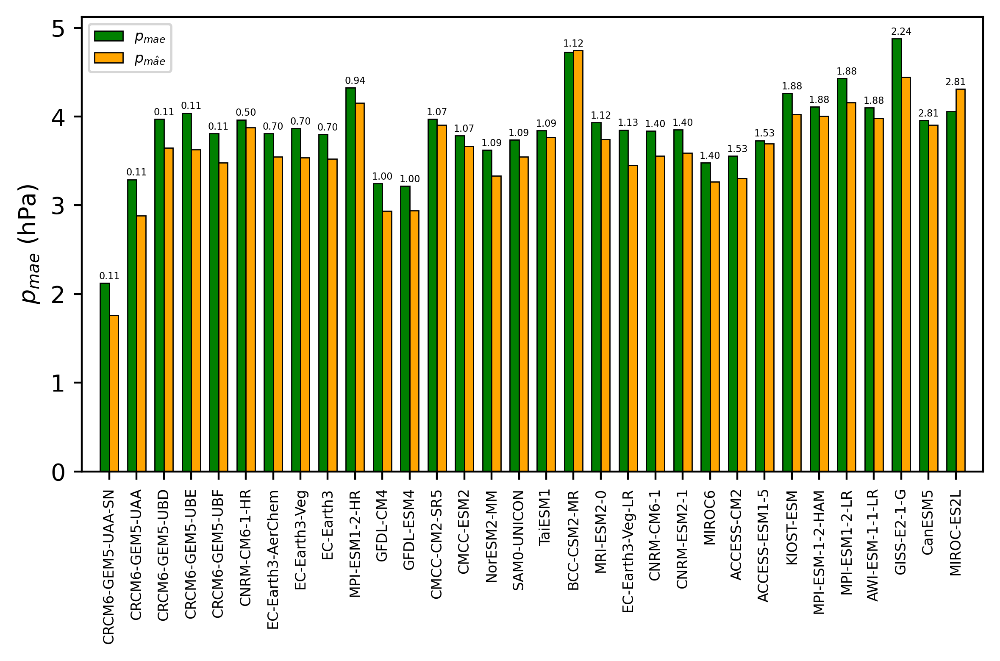

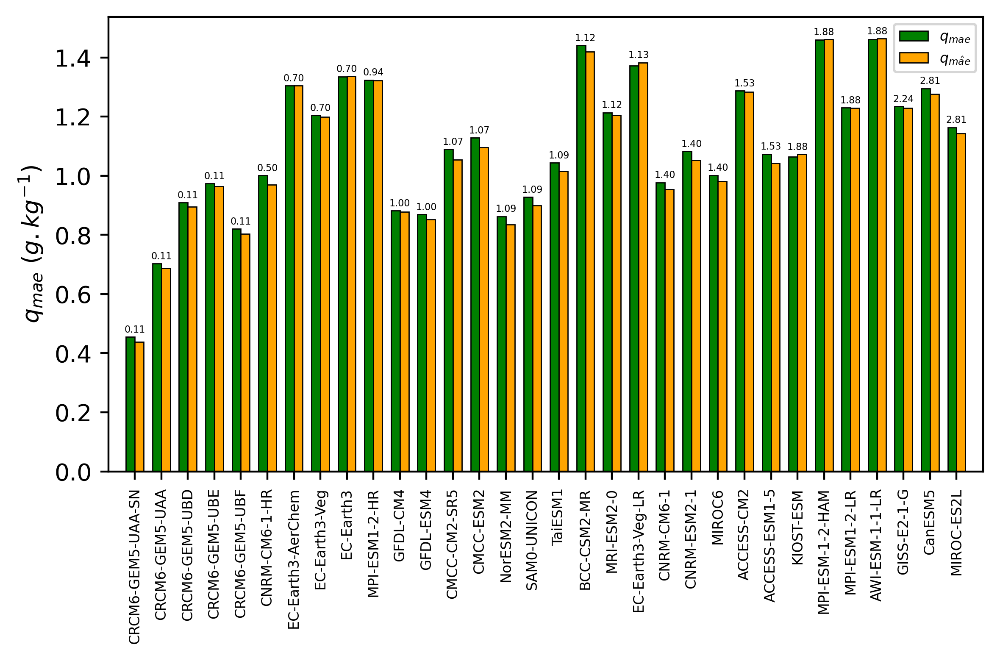

In [15]:
mae_barplot(region='All', save='False')

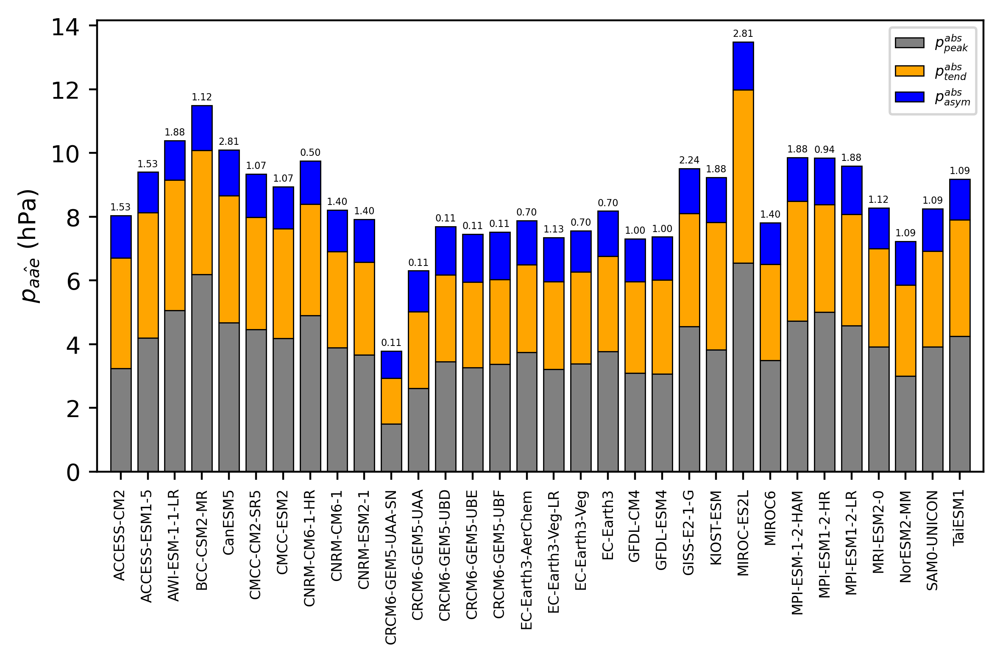

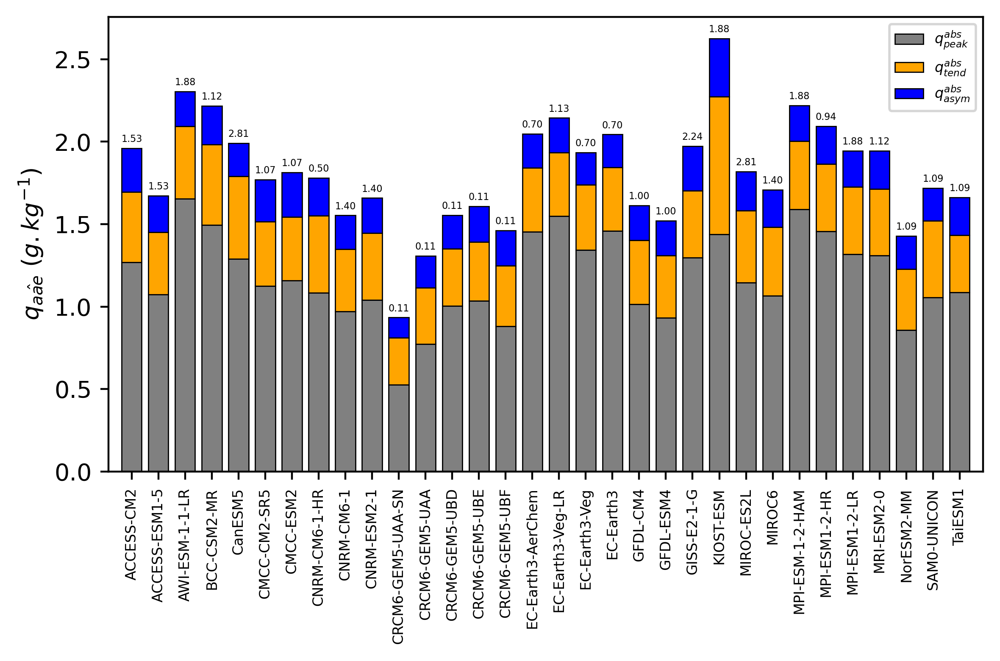

In [16]:
aae_barplot(region='All', save='False')

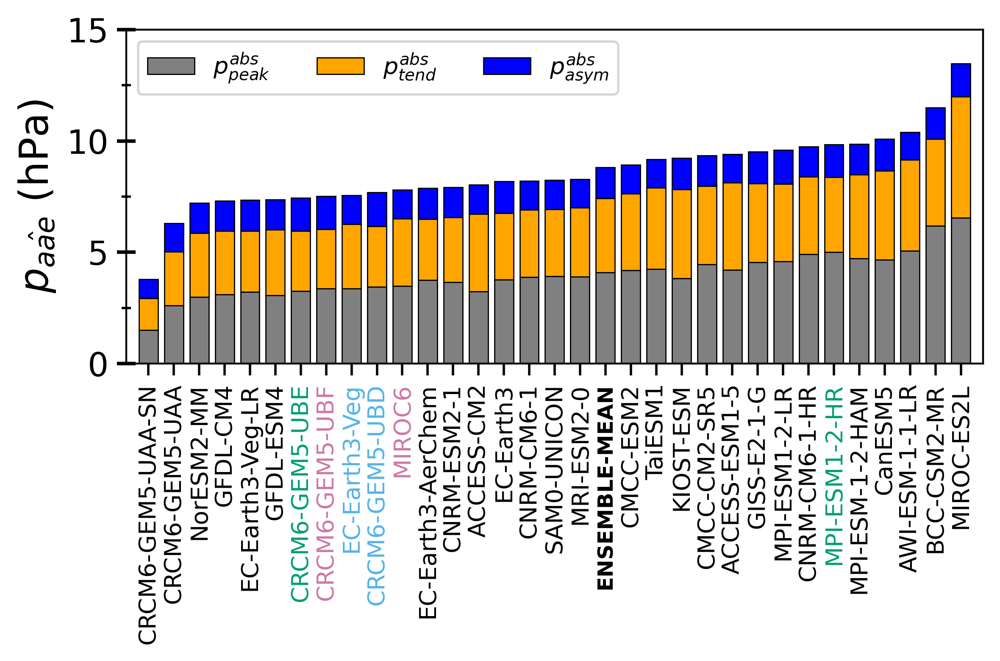

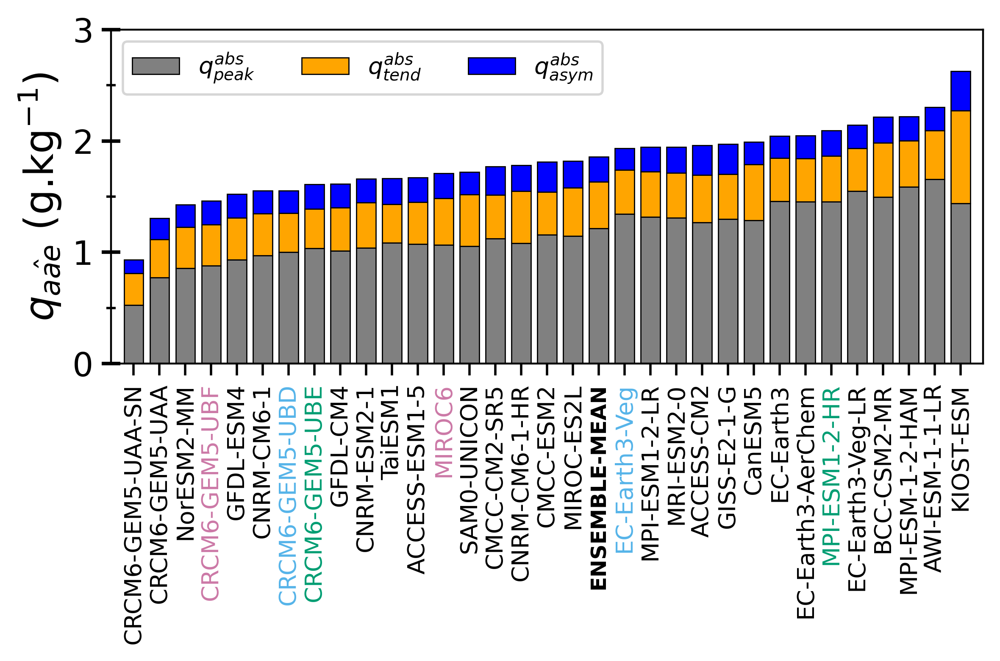

In [29]:
aae_barplot_ranking(region='All', save='False', plim=15, qlim=3)

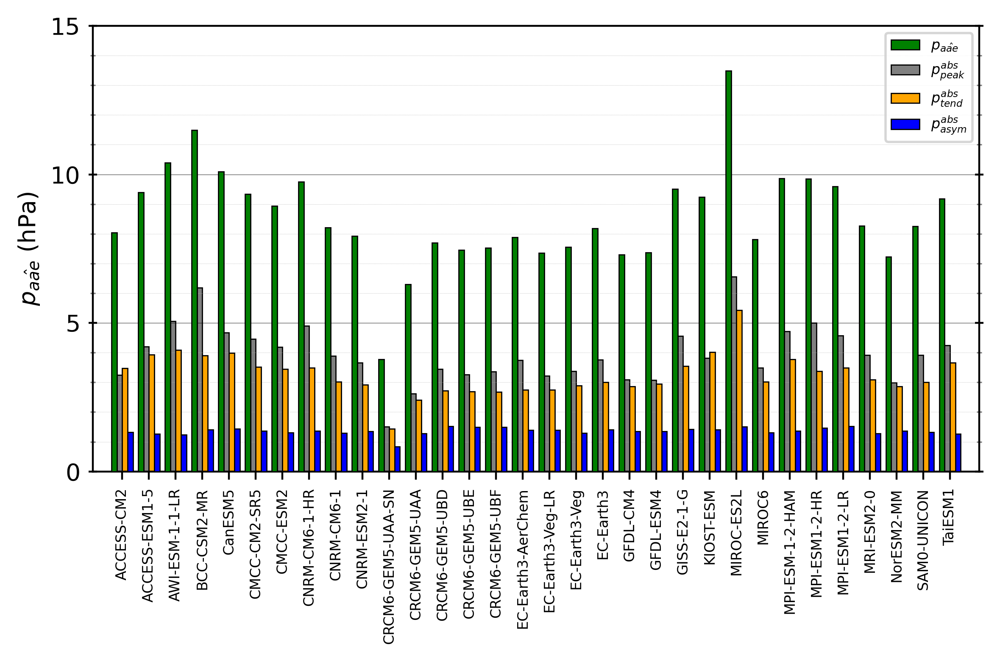

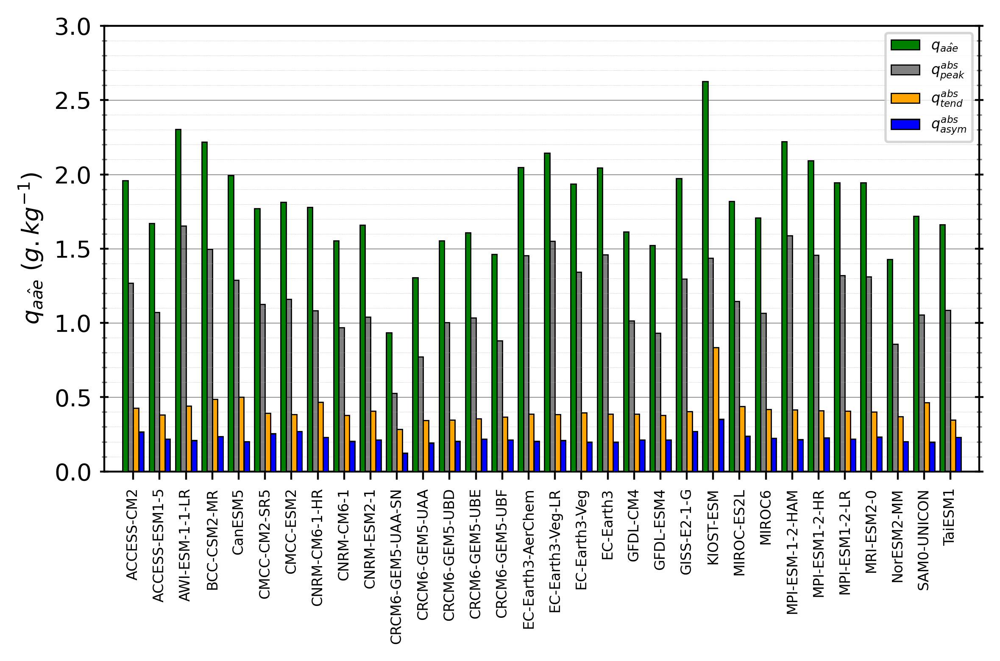

In [ ]:
aae_barplot_large(region='All', save='False')

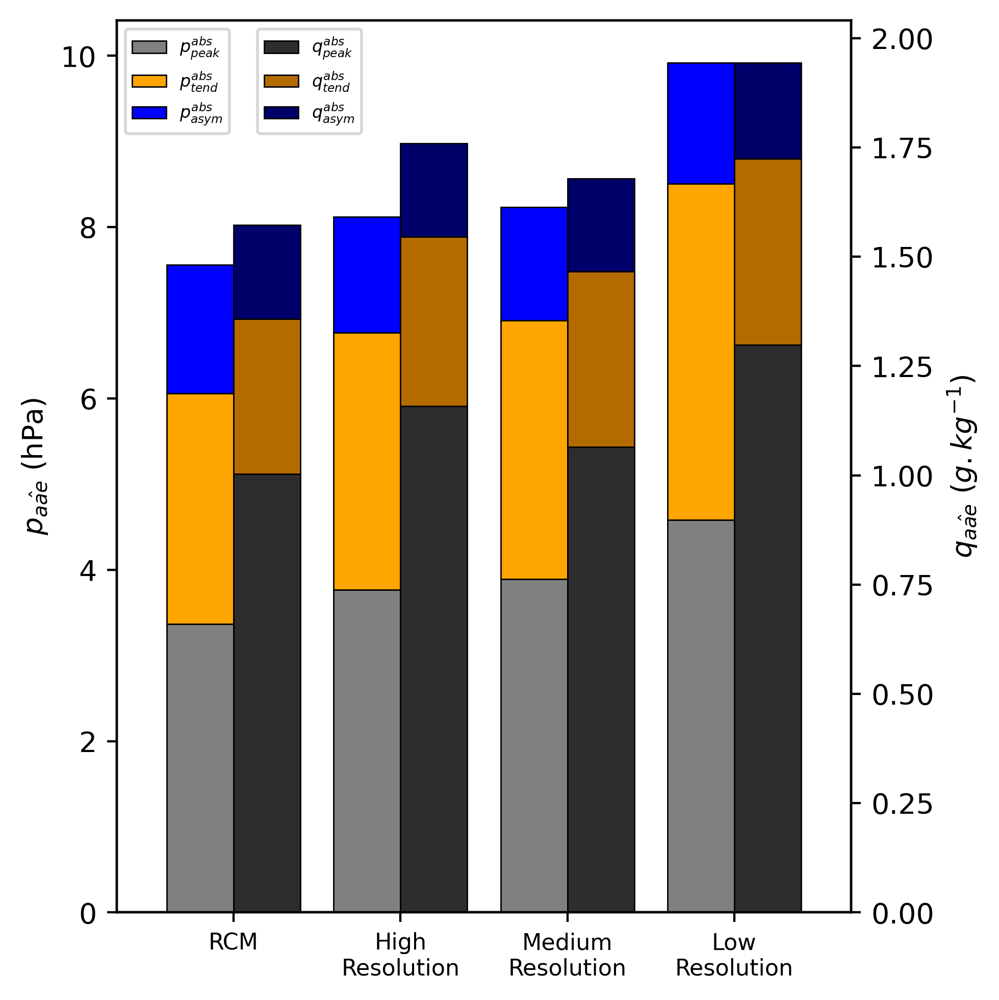

In [19]:
grp_res_aae_barplot(region='All')

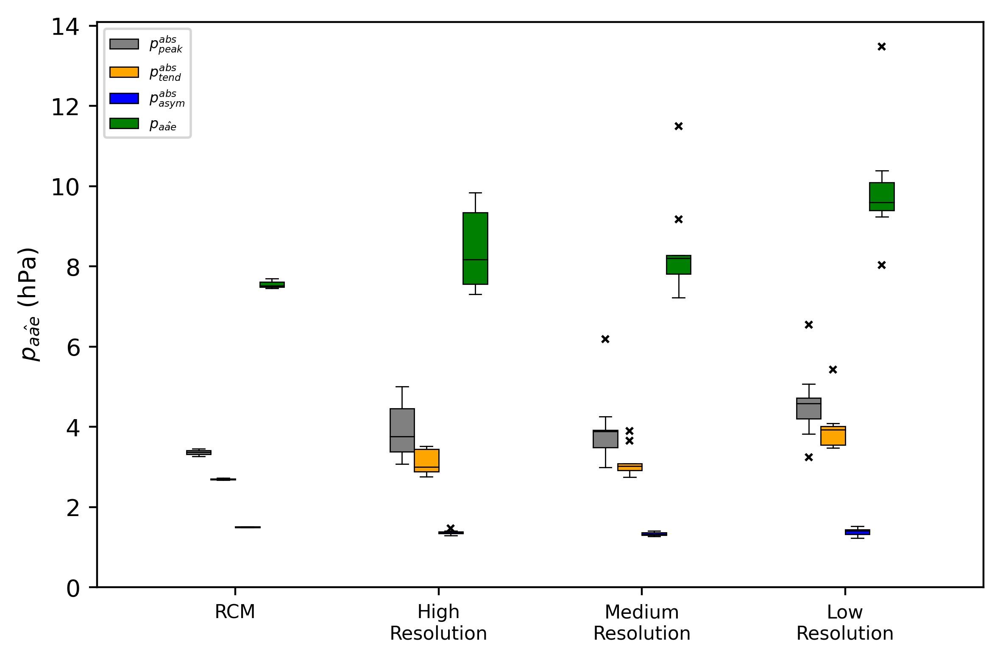

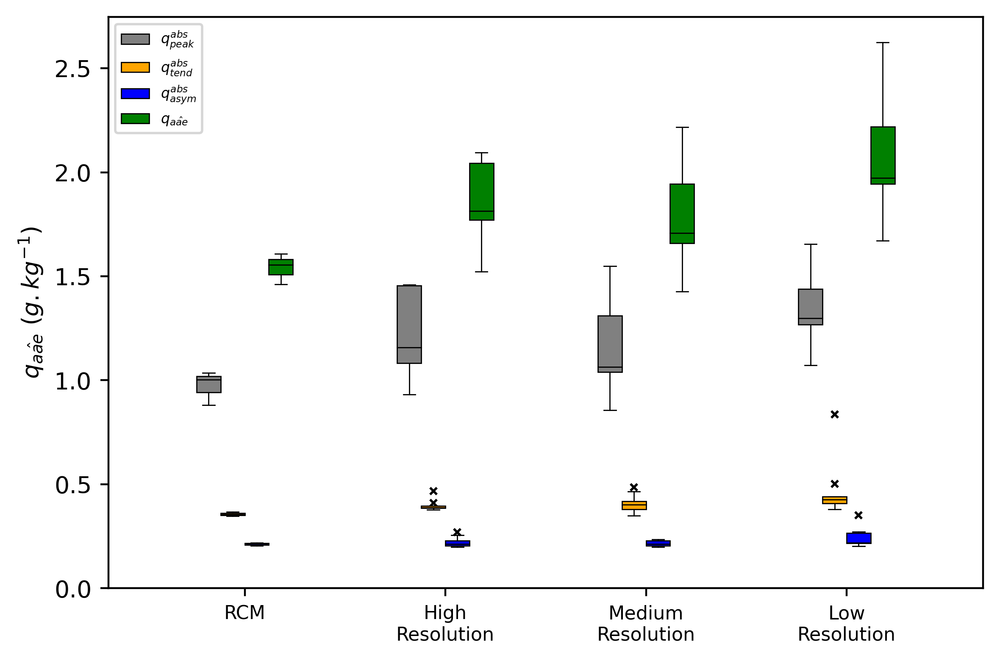

In [20]:
grp_res_aae_boxplot(region='All')

## North Atlantic region

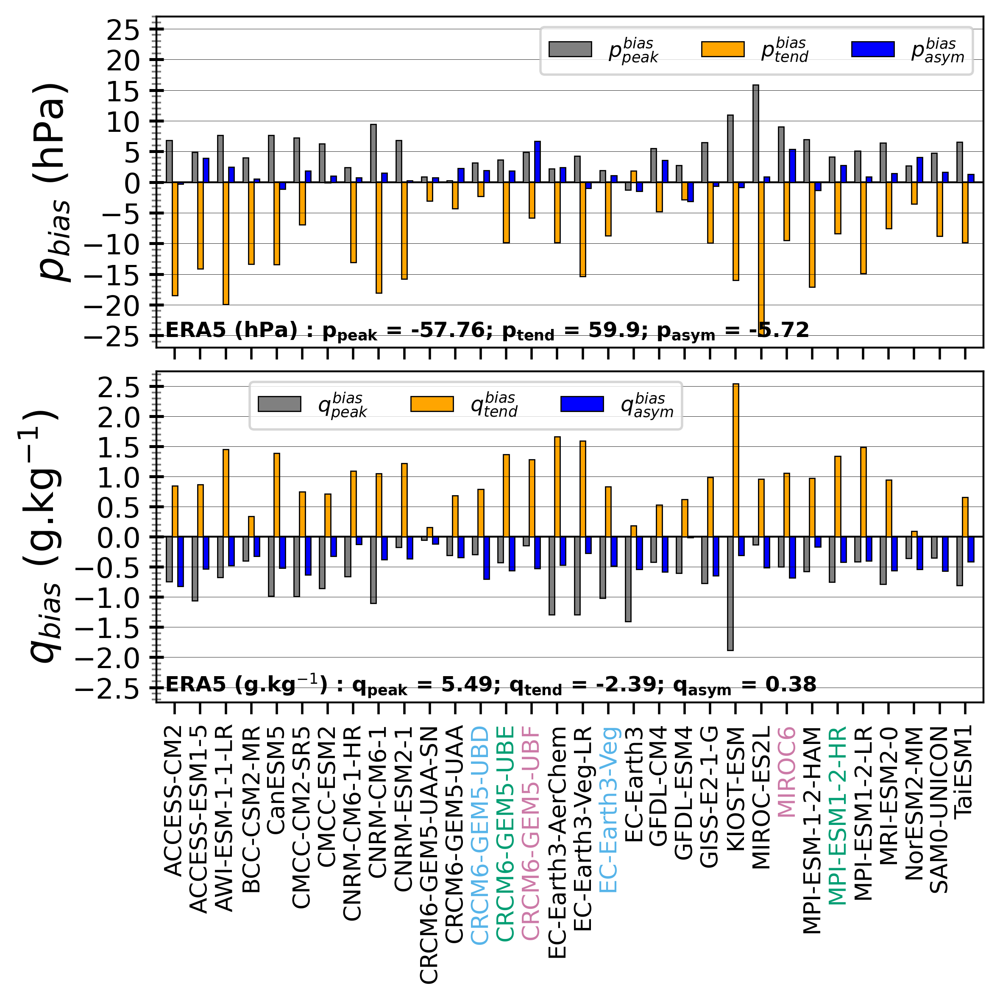

In [43]:
bias_barplot_large(plim=27, qlim=2.75, region=regions['n_atlantic'], save='True')

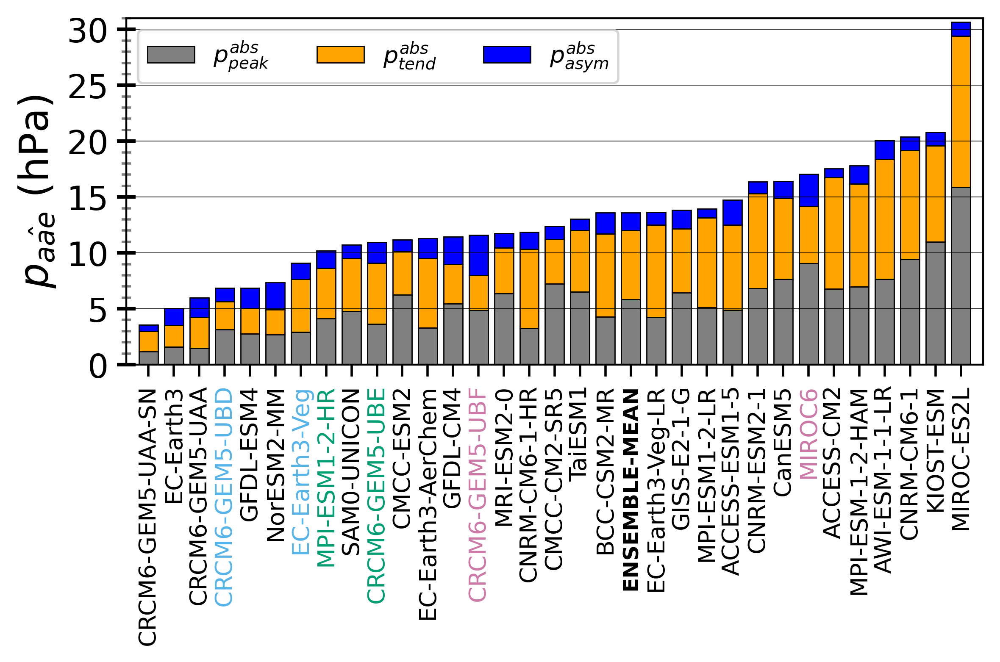

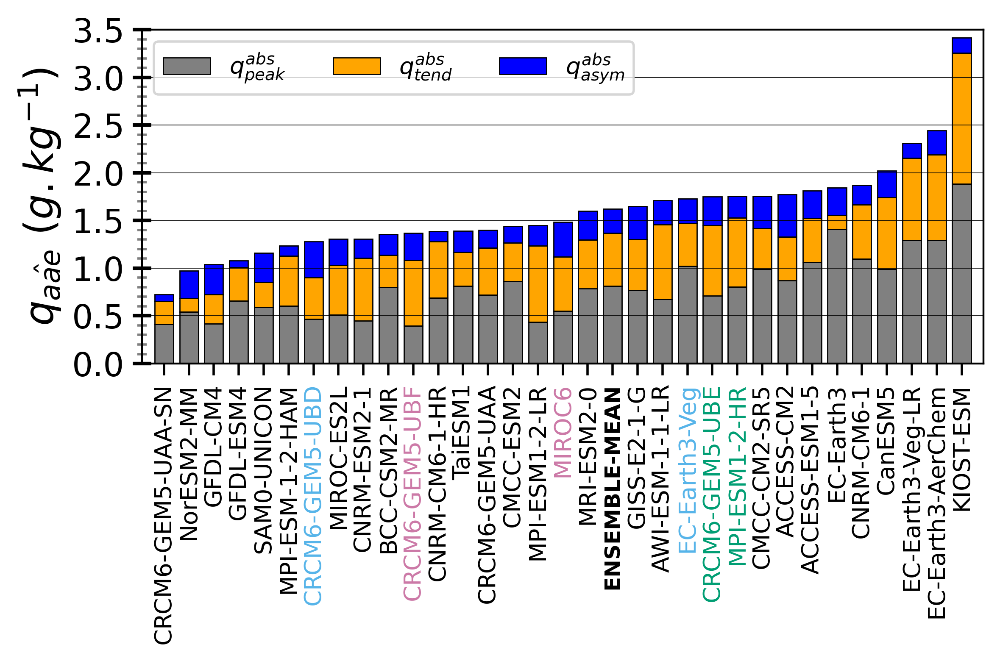

In [15]:
aae_barplot_ranking(plim=31, qlim=3.5, region=regions['n_atlantic'], save='True')

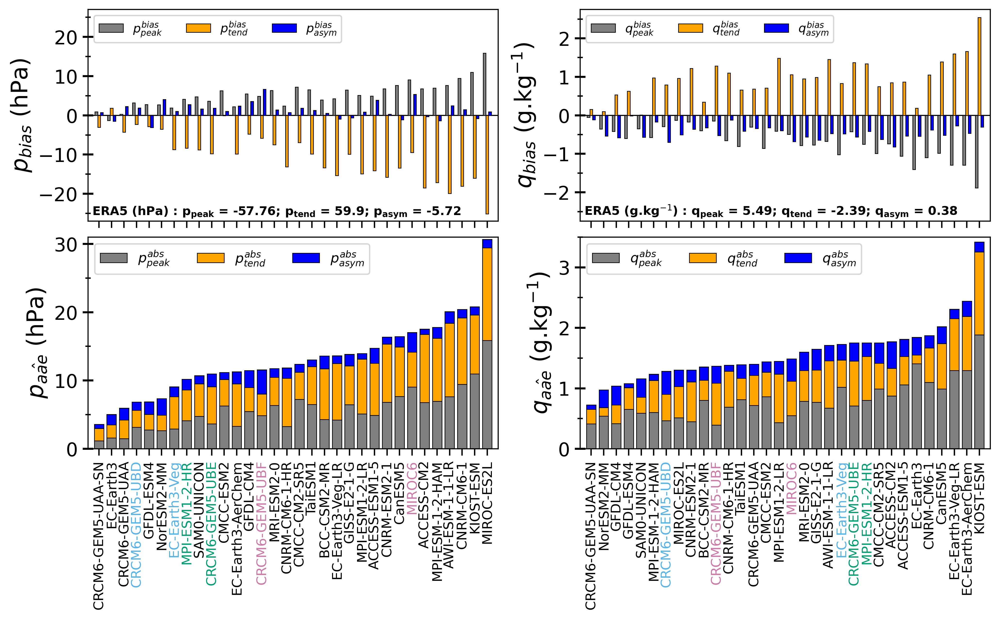

In [145]:
bias_aae_barplot_large_ranking(plim_bias=27, qlim_bias=2.75, plim_aae=31, qlim_aae=3.5, region=regions['n_atlantic'], save='False')

## Western Canadian domain

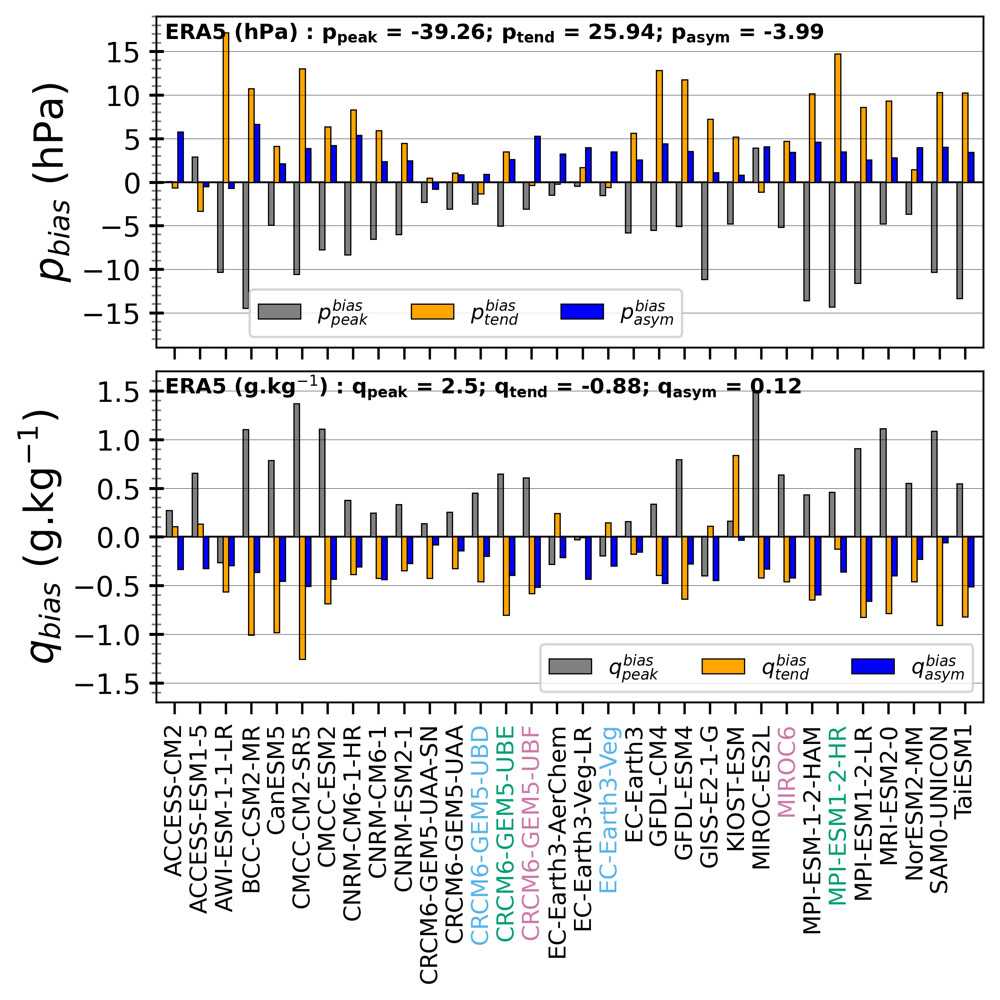

In [44]:
bias_barplot_large(plim=19, qlim=1.7, region=regions['w_canada'], save='True')

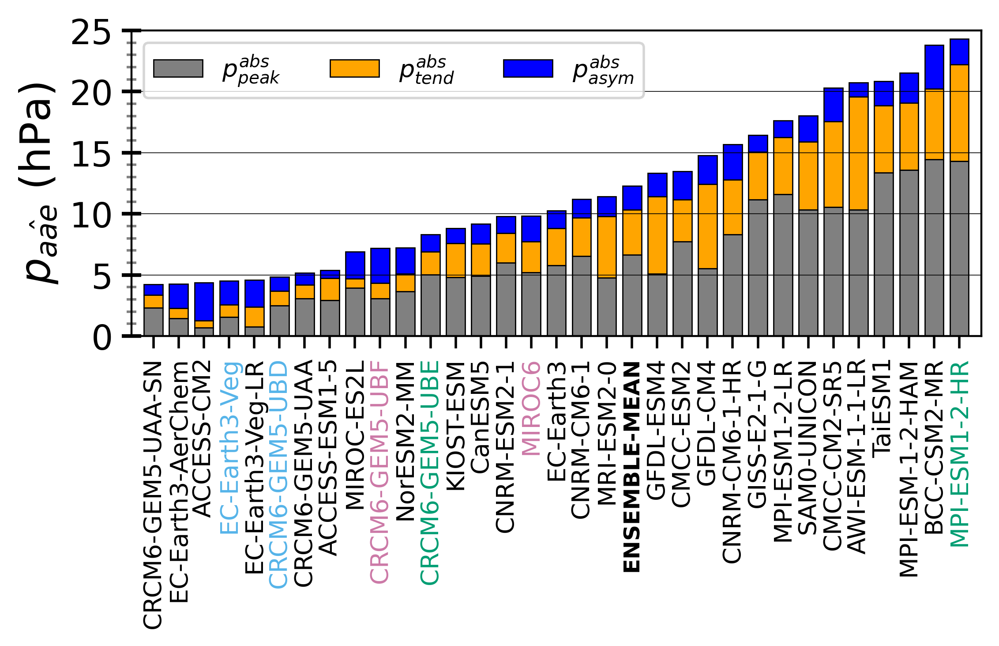

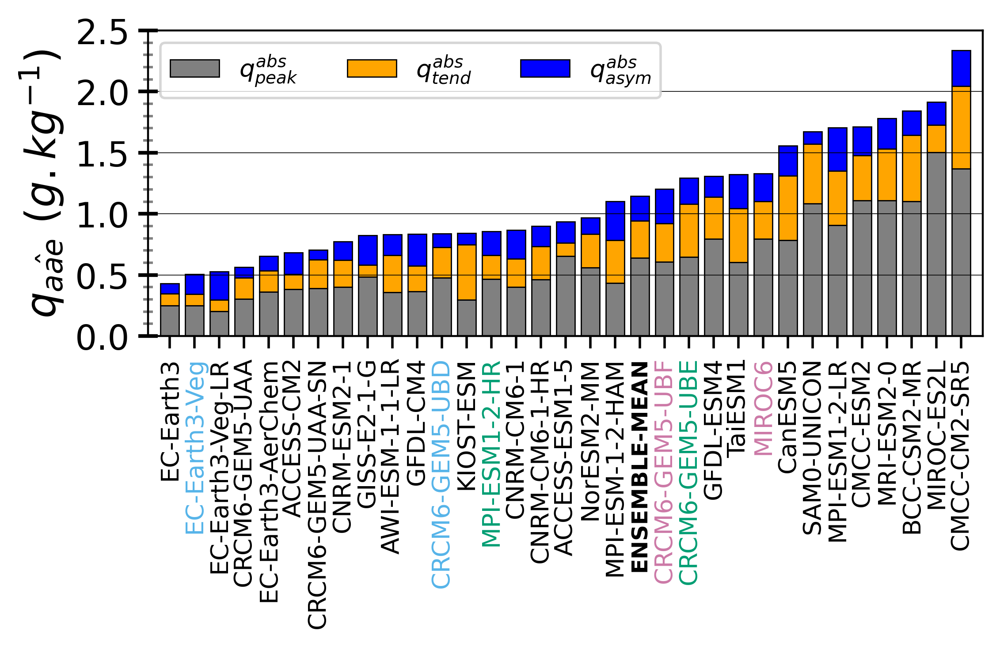

In [45]:
aae_barplot_ranking(plim=25, qlim=2.5, region=regions['w_canada'], save='True')

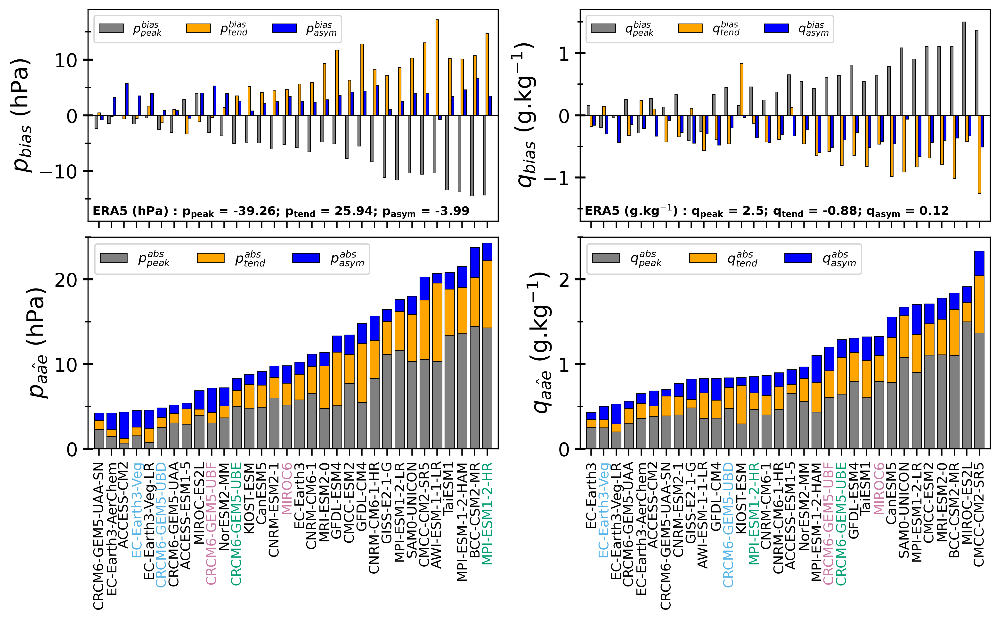

In [146]:
bias_aae_barplot_large_ranking(plim_bias=19, qlim_bias=1.7, plim_aae=25, qlim_aae=2.5, region=regions['w_canada'], save='False')

## Eastern Canadian domain

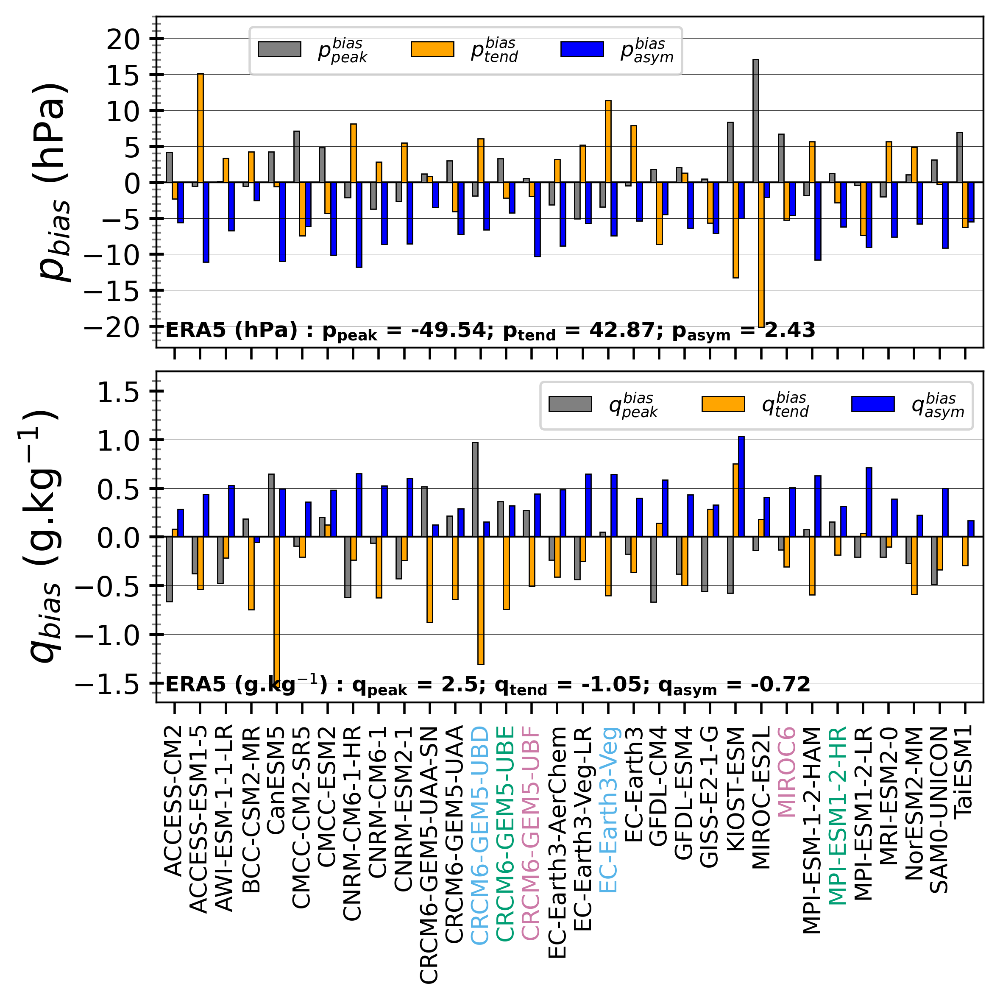

In [45]:
bias_barplot_large(plim=23, qlim=1.7, region=regions['e_canada'], save='True')

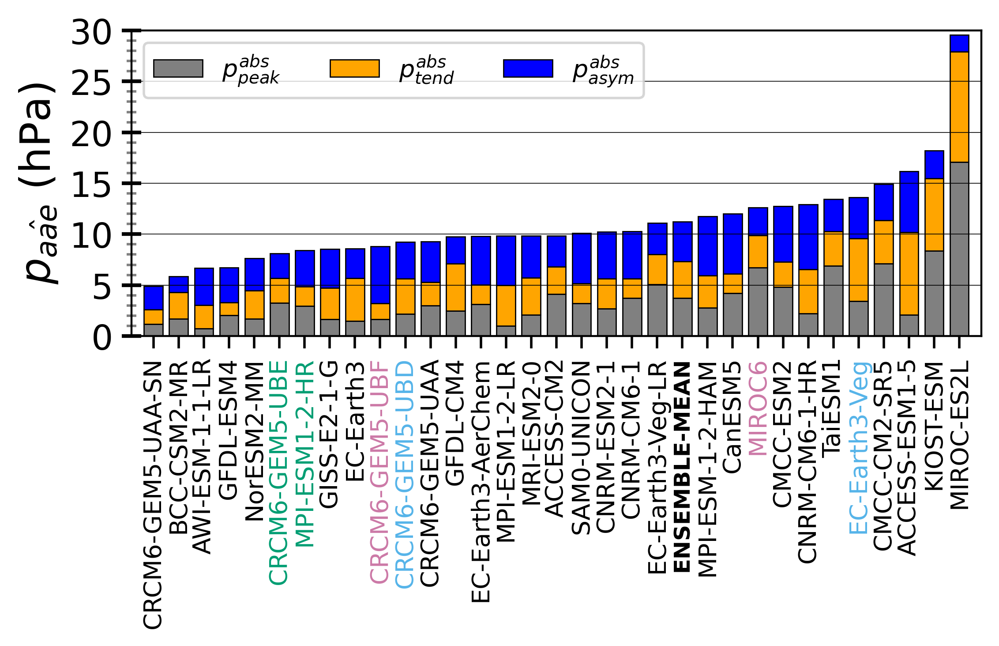

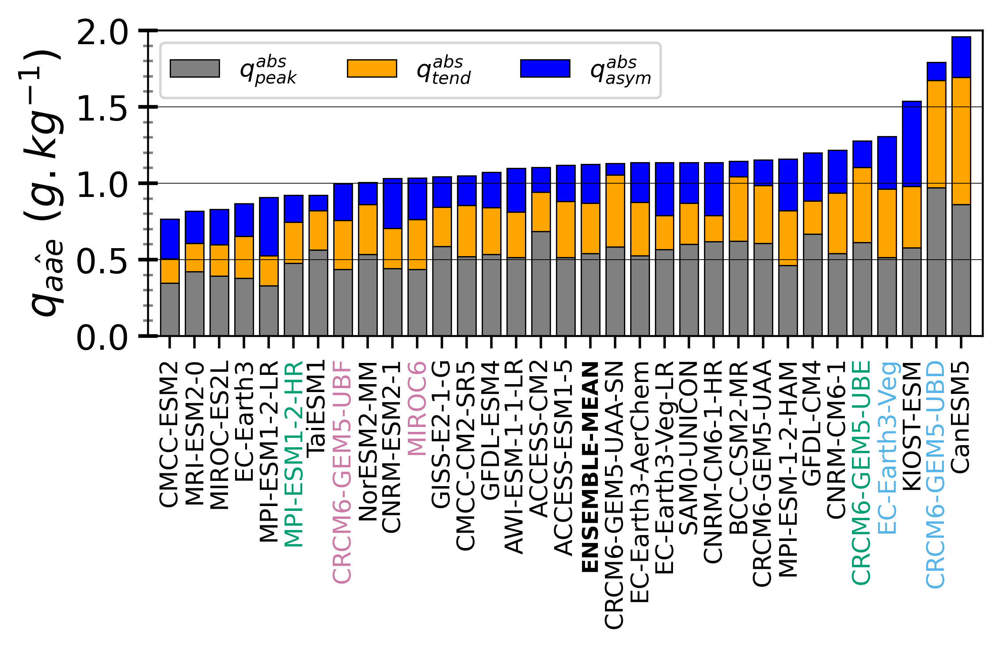

In [47]:
aae_barplot_ranking(plim=30, qlim=2, region=regions['e_canada'], save='True')

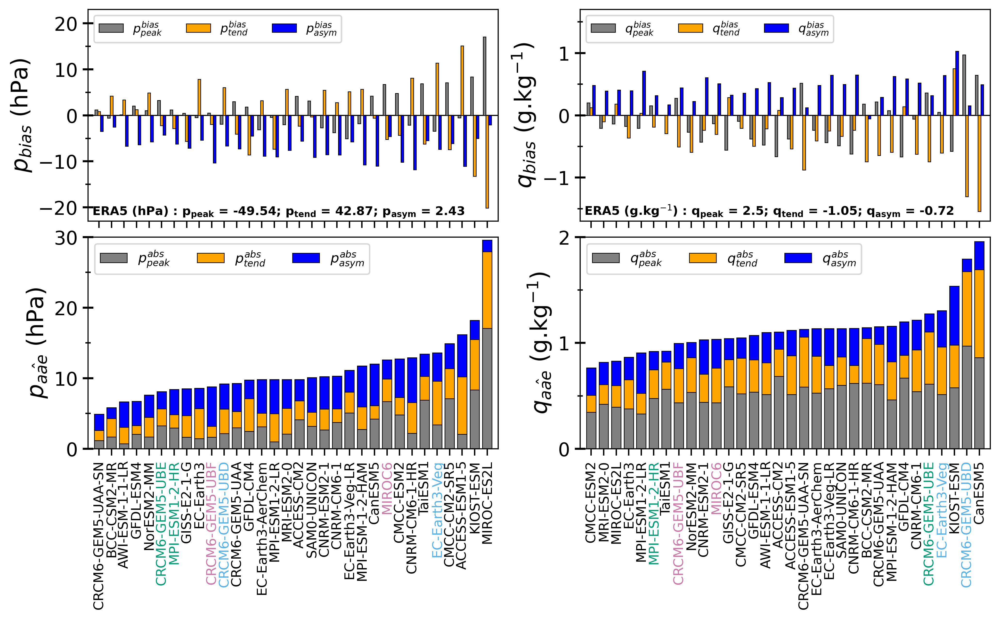

In [147]:
bias_aae_barplot_large_ranking(plim_bias=23, qlim_bias=1.7, plim_aae=30, qlim_aae=2, region=regions['e_canada'], save='False')

## Texas

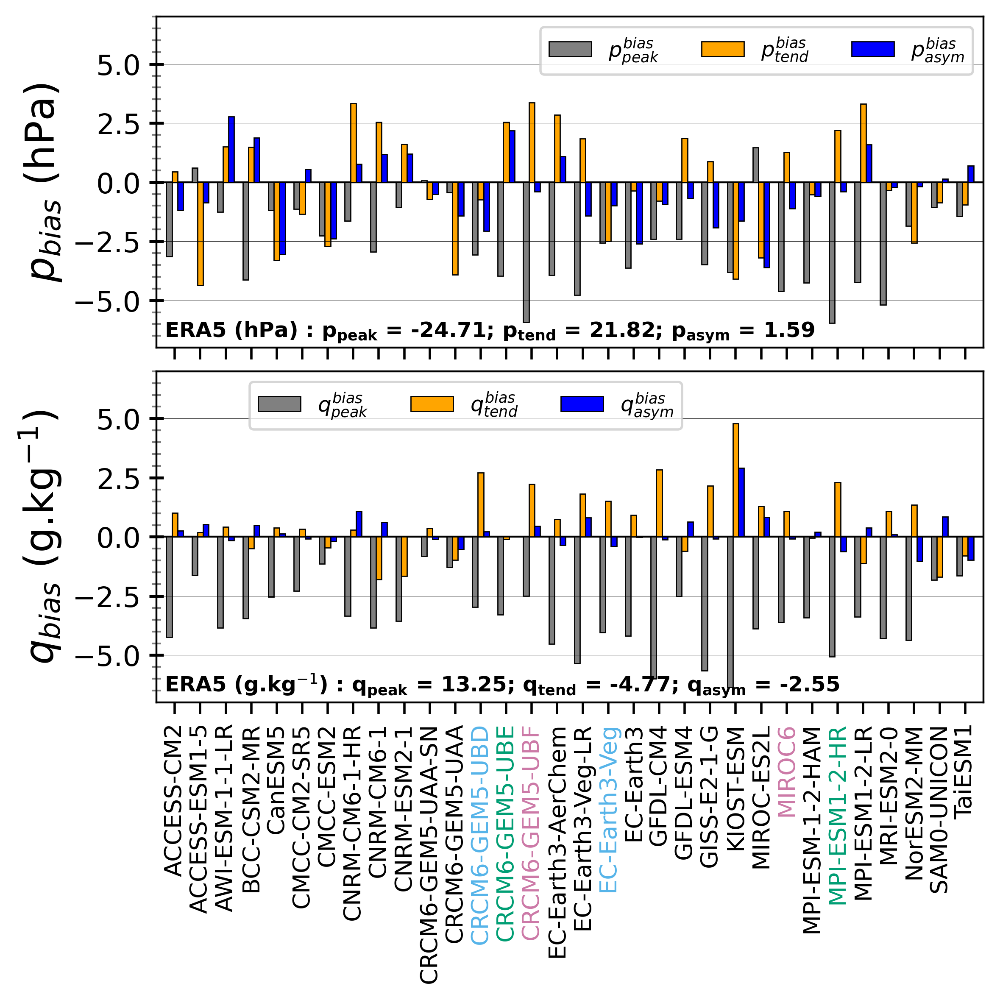

In [46]:
bias_barplot_large(plim=7, qlim=7, region=regions['gulf_mexico'], save='True')

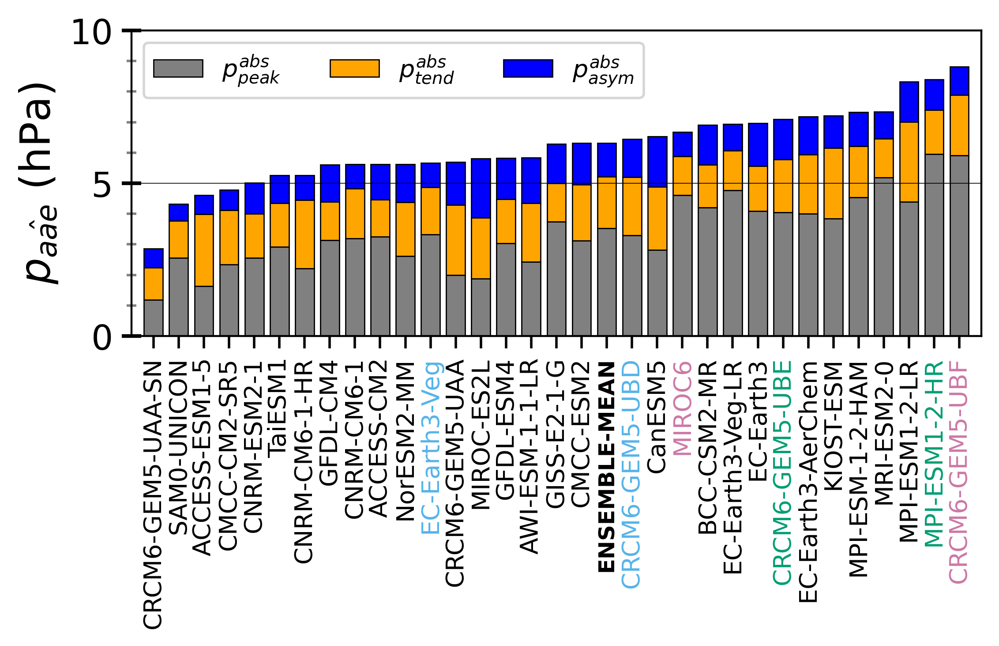

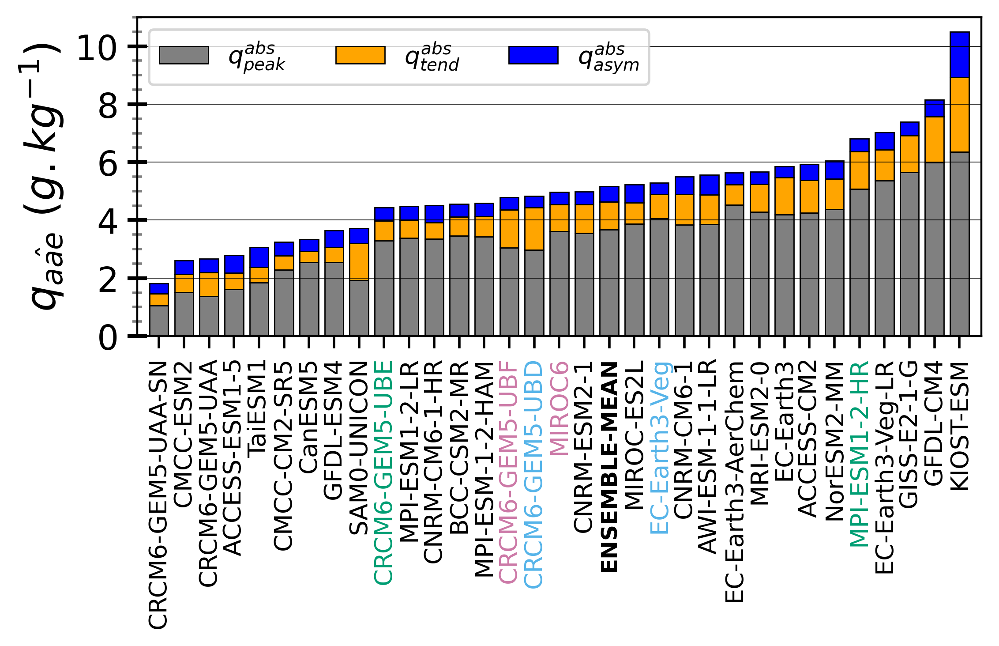

In [ ]:
aae_barplot_ranking(plim=10, qlim=10, region=regions['gulf_mexico'], save='True')

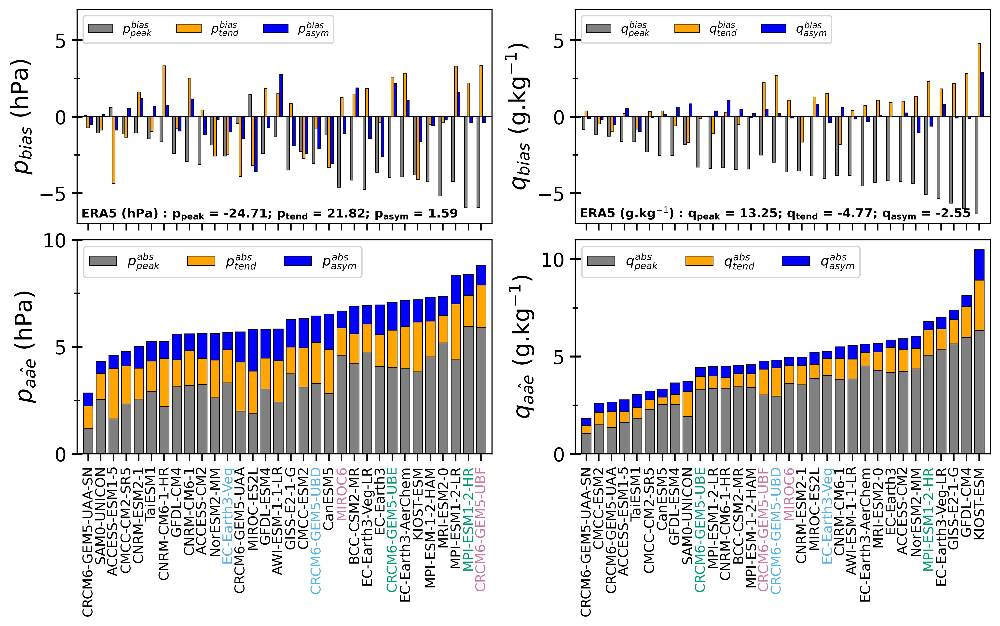

In [148]:
bias_aae_barplot_large_ranking(plim_bias=7, qlim_bias=7, plim_aae=10, qlim_aae=11, region=regions['gulf_mexico'], save='False')

## Quebec

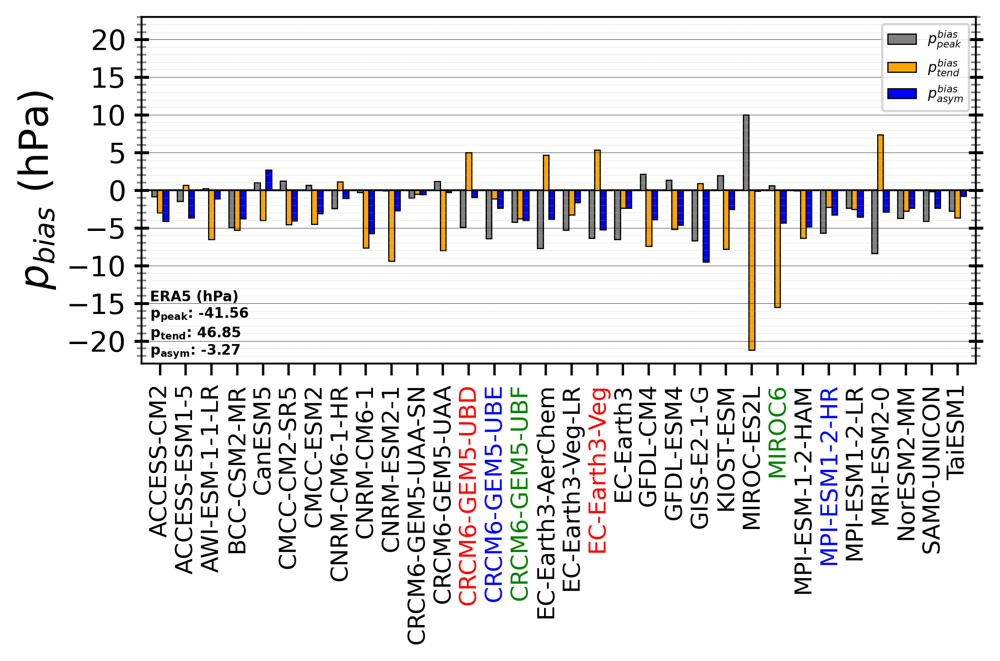

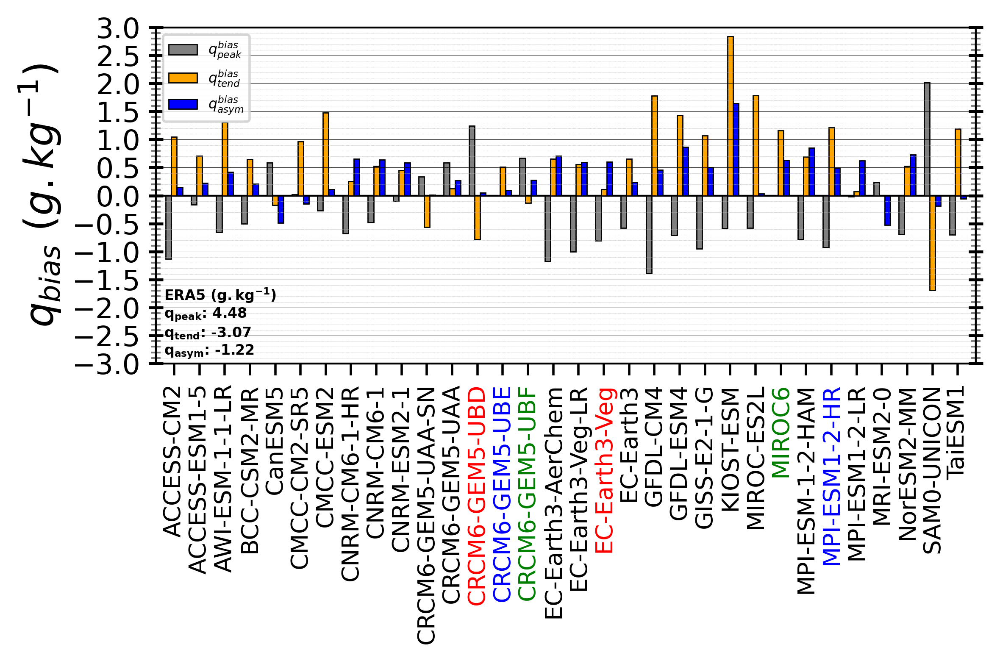

In [78]:
bias_barplot_large(plim=23, qlim=3, region=regions['quebec'], save='False')

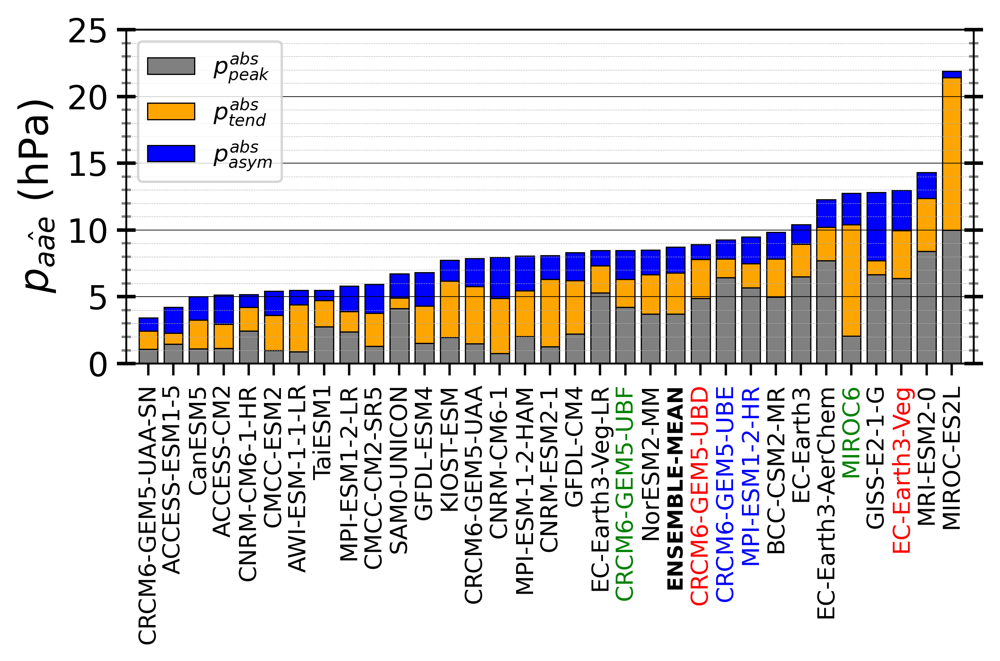

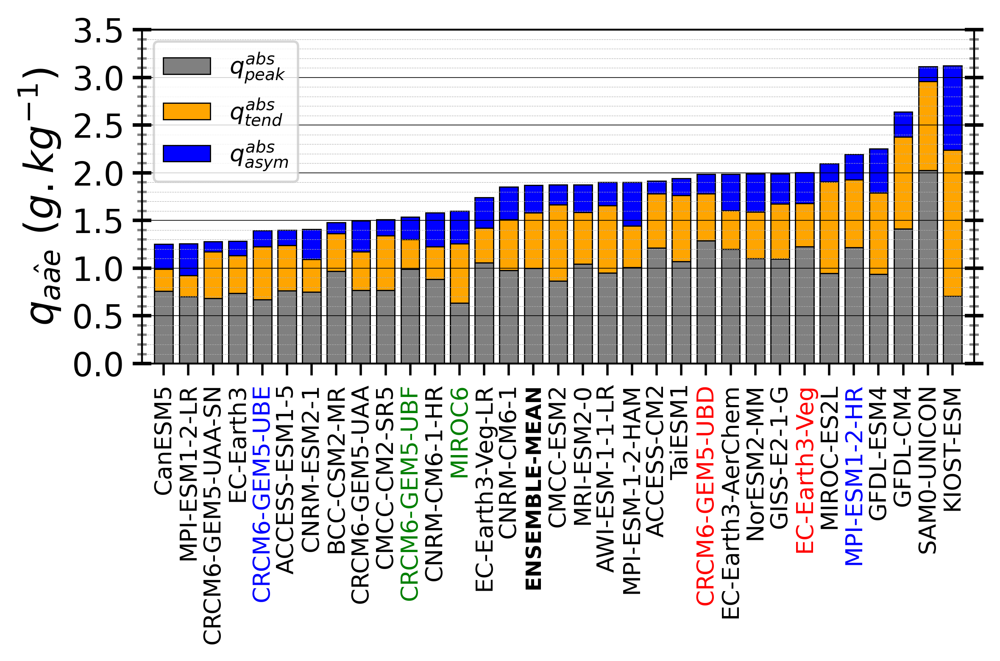

In [79]:
aae_barplot_ranking(plim=25, qlim=3.5, region=regions['quebec'], save='False')

## Summary map

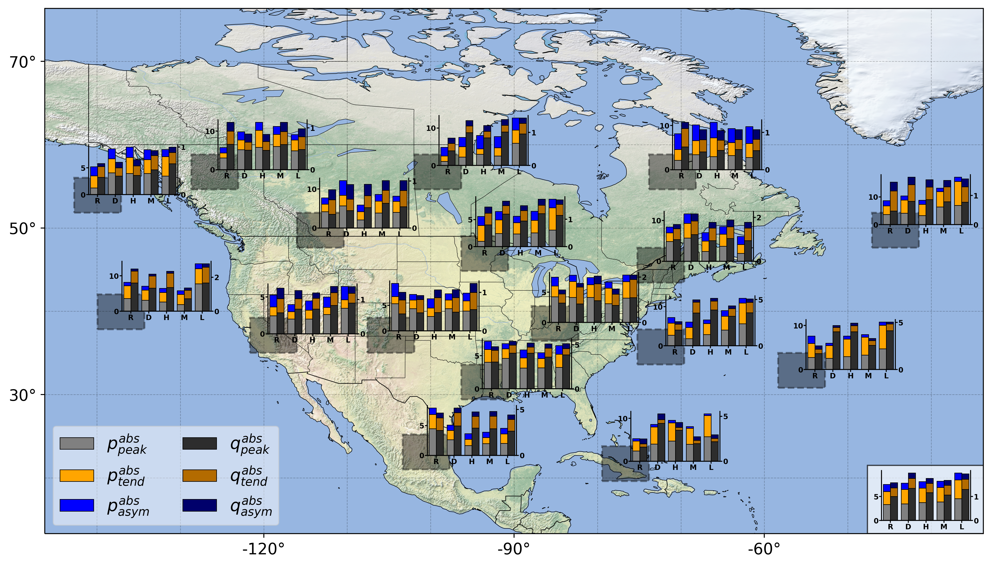

In [23]:
map_barplot(save='False')